In [2]:
exp_name = 'dpl_003'

In [3]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="0"

In [4]:
import torch
import torch.nn as nn
import torchvision
from torch.autograd import Variable
from torch.nn import functional as F

import numpy as np
from scipy import misc
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from multiprocessing import Process, Queue

In [5]:
import pickle
import csv
import os
import time
import datetime
import lmdb


In [5]:
def save_obj(obj, name ):
    with open( name + '.pkl', 'wb') as f:
        pickle.dump(obj, f, pickle.HIGHEST_PROTOCOL)

def load_obj(name ):
    with open( name + '.pkl', 'rb') as f:
        return pickle.load(f)

now = datetime.datetime.now().strftime("%Y-%m-%d %H:%M")
logfile = open(f'../../log/{exp_name}.txt', 'a')
logfile.write(f'\n\n\n\n ----------------- {now} ----------------- \n\n')
logfile.flush()
def log(string, stdout=True):
    if stdout:
        print(string)
    logfile.write(string + '\n')
    logfile.flush()

In [7]:
with open('../../metadata/250_handpicked_labels.csv', 'r') as fin:
    all_labels = [item.strip() for item in fin]
all_labels.append('background')
    
label2idx = {}
for i, l in enumerate(all_labels):
    label2idx[l] = i
    

In [7]:
with open('../../../data/seedling/jpg.txt', 'r') as fin:
    test_img_filenames = [line.strip() for line in fin]
test_img_filenames = ['../../../data/seedling/' + item for item in test_img_filenames]

In [8]:
resnet = torchvision.models.resnet50() # resnet.eval() is very important, do not forget this line during testing!
print(resnet.fc)
resnet.fc = nn.Linear(2048, len(all_labels)-1)
#saved_state_dict = torch.load(os.path.join('data/snapshots/','d2_rel_open_1600.pth'))
saved_state_dict = torch.load(os.path.join('../../snapshots', 'train_013', 'ckpt_5000'))
resnet.load_state_dict(saved_state_dict)
resnet.cuda(0)
resnet.eval()
resnet.float()

Linear(in_features=2048, out_features=1000, bias=True)


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=F

In [9]:
finalconv_name = 'layer4'

# hook the feature extractor
features_blobs = []
def hook_feature(module, input, output):
    features_blobs.append(output.data.cpu().numpy())

resnet._modules.get(finalconv_name).register_forward_hook(hook_feature)

# get the softmax weight
params = list(resnet.parameters())
weight_softmax = np.squeeze(params[-2].cpu().data.numpy())

def returnCAM(feature_conv, weight_softmax, class_idx):
    # generate the class activation maps upsample to 256x256
    size_upsample = (256, 256)
    bz, nc, h, w = feature_conv.shape
    output_cam = []
    for idx in class_idx:
        if all_labels[idx] == 'background':
            output_cam.append(None)
        else:
            cam = weight_softmax[idx].dot(feature_conv.reshape((nc, h*w)))
            cam = cam.reshape(h, w)
            cam = cam - np.min(cam)
            cam_img = cam / np.max(cam)
            cam_img = np.uint8(255 * cam_img)
            output_cam.append(cv2.resize(cam_img, size_upsample))
    return output_cam


In [10]:
def get_bbox(fid):
    bbox_threshold = [20, 100, 110]
    curParaThreshold = str(bbox_threshold[0]) + ' ' + str(bbox_threshold[1]) + ' ' + str(bbox_threshold[2])
    curHeatMapFile = f'../../CAM/bboxgenerator/heatmap_{fid}.jpg'
    # curImgFile = 'sample_6.jpg'
    curBBoxFile = f'../../CAM/bboxgenerator/heatmap_{fid}.txt'
    cmd = '../../CAM/bboxgenerator/./dt_box ' + curHeatMapFile + ' ' + curParaThreshold + ' ' + curBBoxFile
    if os.path.isfile(curBBoxFile):
        os.remove(curBBoxFile)
    os.system(cmd)
    lines = open(curBBoxFile).readlines()
    boxData = np.asarray(lines[0].split(),dtype= float)
    a = boxData[0::4]
    b = boxData[1::4]
    c = boxData[0::4] + boxData[2::4]
    d = boxData[1::4]+ boxData[3::4]
    boxData_formulate = np.vstack((a,b,c,d)).T
    a = np.minimum(boxData_formulate[:,0],boxData_formulate[:,2])
    b = np.minimum(boxData_formulate[:,1],boxData_formulate[:,3])
    c = np.maximum(boxData_formulate[:,0],boxData_formulate[:,2])
    d = np.maximum(boxData_formulate[:,1],boxData_formulate[:,3])
    boxData_formulate = np.vstack((a,b,c,d)).T
    return boxData_formulate

In [11]:
q_cam = Queue()
q_bbox = Queue()

In [12]:
def fn(pid):
    while(True):
        item = q_cam.get()    
        if item == 'DONE':
            q_bbox.put('DONE')
            return
        key, CAMs = item
        topk_box = []
        for iii in range(len(CAMs)):
            if CAMs[iii] is None:
                topk_box.append(None)
            else:
                heat_resized = cv2.resize(CAMs[iii],(224, 224))
                cv2.imwrite(f'../../CAM/bboxgenerator/heatmap_{pid}.jpg', heat_resized)
                bbox = get_bbox(pid)
                bbox = bbox.astype('float32') / 224.0
                topk_box.append(bbox)

        q_bbox.put((key, topk_box))
            
    

In [13]:
proc = []
n_proc = 20
for i in range(n_proc):
    proc.append(Process(target=fn, args=(i,)))

In [14]:
for p in proc:
    p.start()

In [15]:
batch_size = 100
det_results = {}
batch = []
batch_keys = []
for i, filename in enumerate(test_img_filenames):
    try:
        with open(filename, 'rb') as fin:
            _ = fin.read(1024)
            imgbin = fin.read()
        imgbgr = cv2.imdecode(np.fromstring(imgbin, dtype='uint8'), cv2.IMREAD_COLOR)
        imgbgr = cv2.resize(imgbgr, (224, 224))
        imgrgb = imgbgr[:,:,[2,1,0]]        
        assert(imgrgb.shape[0] == 224 and imgrgb.shape[1] == 224 and imgrgb.shape[2] == 3)
    except Exception as ex:
        log(str(ex))
        continue
    
    imgrgb = imgrgb.astype(float)/255.0
    
    imgrgb[:,:,0] = (imgrgb[:,:,0] - 0.485)/0.229
    imgrgb[:,:,1] = (imgrgb[:,:,1] - 0.456)/0.224
    imgrgb[:,:,2] = (imgrgb[:,:,2] - 0.406)/0.225

    imgrgb = imgrgb.transpose((2,0,1))
    batch.append(imgrgb)
    imgid = filename.split('/')[-1]
    batch_keys.append(imgid)
    
    if len(batch) == batch_size or (i + 1) == len(test_img_filenames):
        batch = np.stack(batch)
    
        features_blobs = []
        
        with torch.no_grad():
            inp = torch.from_numpy(batch).float().cuda(0)
            outputs = resnet(inp)
            outputs = torch.cat([outputs, torch.ones(batch.shape[0], 1).cuda(0)], dim=1)
            h_x = F.softmax(outputs).data.squeeze()
            probs, idx = h_x.sort(1, True)
            idx = np.asarray(idx)
            probs = np.asarray(probs)
        
        for ii in range(len(batch_keys)):            
            CAMs = returnCAM(features_blobs[0][ii:ii+1], weight_softmax, list(idx[ii]))
            q_cam.put((batch_keys[ii], CAMs))
            det_results[batch_keys[ii]] = {
                'sorted_labels': idx[ii],
                'sorted_probs': probs[ii],                
            }

        
        batch = []
        batch_keys = []
        log(f'processed {i + 1} out of {len(test_img_filenames)} images.')

/home/alireza/home_at_filer2/tools/anaconda3/envs/py3torch/lib/python3.6/site-packages/ipykernel/__main__.py:10: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/home/alireza/home_at_filer2/tools/anaconda3/envs/py3torch/lib/python3.6/site-packages/ipykernel/__main__.py:38: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.


processed 100 out of 3691 images.
processed 200 out of 3691 images.
processed 800 out of 3691 images.
processed 900 out of 3691 images.
processed 1000 out of 3691 images.
processed 1100 out of 3691 images.
processed 1200 out of 3691 images.
processed 1300 out of 3691 images.
processed 1400 out of 3691 images.
processed 1500 out of 3691 images.
processed 1600 out of 3691 images.
processed 1700 out of 3691 images.
processed 1800 out of 3691 images.
OpenCV(3.4.1) /io/opencv/modules/imgproc/src/resize.cpp:4044: error: (-215) ssize.width > 0 && ssize.height > 0 in function resize

processed 1901 out of 3691 images.
processed 2001 out of 3691 images.
processed 2101 out of 3691 images.
processed 2201 out of 3691 images.
processed 2301 out of 3691 images.
processed 2401 out of 3691 images.
processed 2501 out of 3691 images.
processed 2601 out of 3691 images.
processed 2701 out of 3691 images.
processed 2801 out of 3691 images.
processed 2901 out of 3691 images.
processed 3001 out of 3691 image

RuntimeError: invalid argument 0: Sizes of tensors must match except in dimension 1. Got 100 and 90 in dimension 0 at /pytorch/aten/src/THC/generic/THCTensorMath.cu:111

In [18]:
for _ in range(n_proc):
    q_cam.put('DONE')

In [19]:
cnt = 0
n_done = 0
while(n_done < n_proc):
    item = q_bbox.get()
    if item == 'DONE':
        n_done += 1
        continue
    key, topk_bbox = item
    det_results[key]['sorted_bboxes'] = topk_bbox
    if cnt % 100 == 0:
        print(f'collected {cnt} out pf {len(test_img_filenames)} results from the queue')
    cnt += 1
for p in proc:
    p.join()        

collected 0 out pf 3691 results from the queue
collected 100 out pf 3691 results from the queue
collected 200 out pf 3691 results from the queue
collected 300 out pf 3691 results from the queue
collected 400 out pf 3691 results from the queue
collected 500 out pf 3691 results from the queue
collected 600 out pf 3691 results from the queue
collected 700 out pf 3691 results from the queue
collected 800 out pf 3691 results from the queue
collected 900 out pf 3691 results from the queue
collected 1000 out pf 3691 results from the queue
collected 1100 out pf 3691 results from the queue
collected 1200 out pf 3691 results from the queue
collected 1300 out pf 3691 results from the queue
collected 1400 out pf 3691 results from the queue
collected 1500 out pf 3691 results from the queue
collected 1600 out pf 3691 results from the queue
collected 1700 out pf 3691 results from the queue
collected 1800 out pf 3691 results from the queue
collected 1900 out pf 3691 results from the queue
collected 20

In [25]:
assert(cnt == len(img_subset))

AssertionError: 

In [20]:
save_obj(det_results, f'../../results/det_results_{exp_name}')

In [20]:
with open('../../data/OpenImages/metadata-v4/class-names/class-descriptions.csv', 'r') as fin:
    mids = list(csv.reader(fin))
name2mid = {}
mid2name = {}
for item in mids:
    mid2name[item[0]] = item[1]
    name2mid[item[1].lower().replace(' ', '')] = item[0]


IC0011X11.jpg.ldcc


/home/alireza/home_at_filer2/tools/anaconda3/envs/py3torch/lib/python3.6/site-packages/ipykernel/__main__.py:9: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


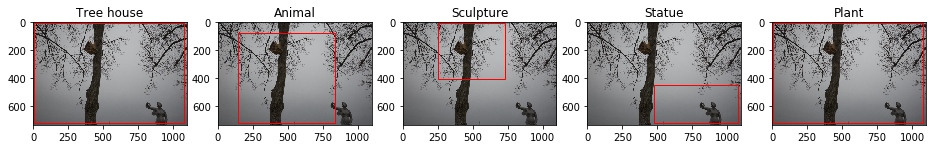

IC0011ZD3.jpg.ldcc


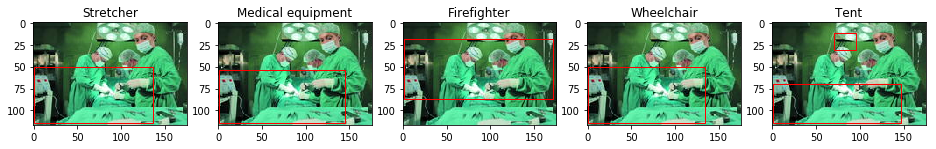

IC0011SRH.jpg.ldcc


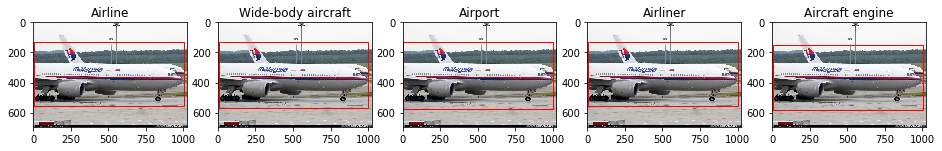

HC000067U.jpg.ldcc


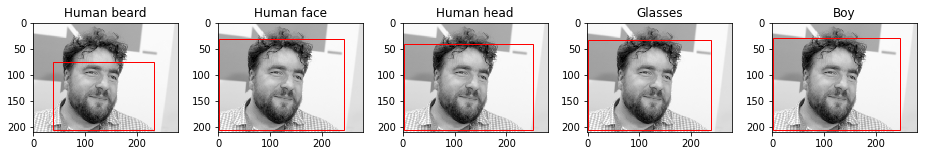

IC0011ULS.jpg.ldcc


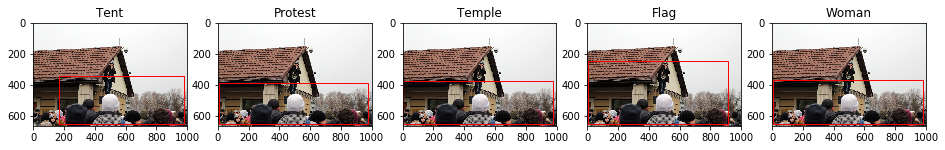

IC0011VDI.jpg.ldcc


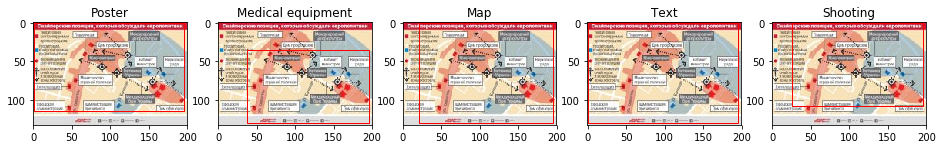

IC0012006.jpg.ldcc


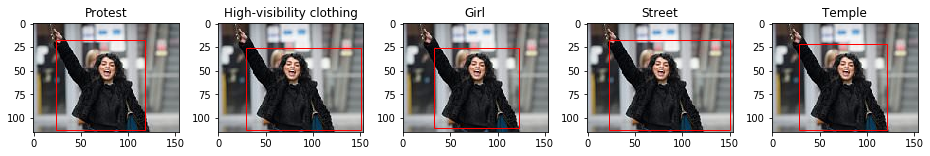

IC0011T6B.jpg.ldcc


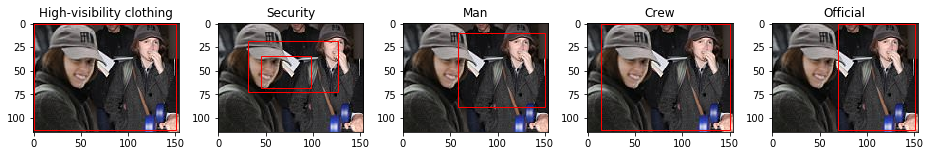

IC0011V8I.jpg.ldcc


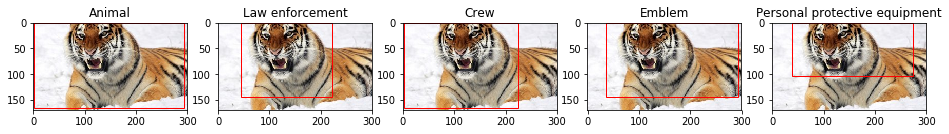

IC0011UHT.jpg.ldcc


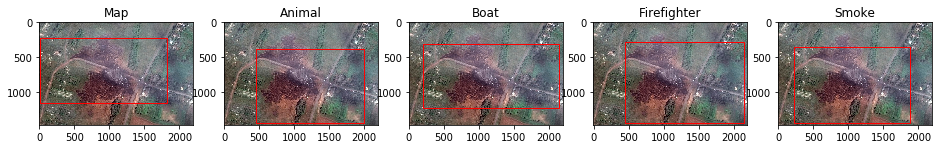

IC00158AB.jpg.ldcc


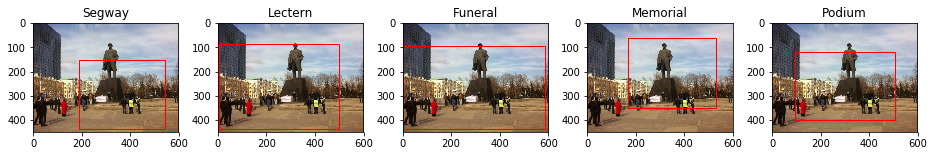

IC0011TDL.jpg.ldcc


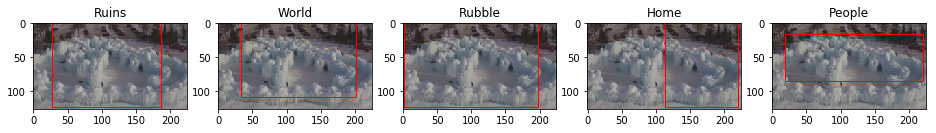

IC0011UQ9.jpg.ldcc


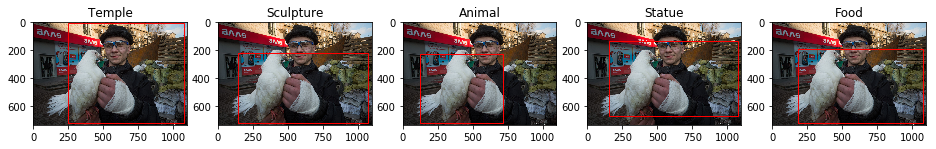

HC00025FS.jpg.ldcc


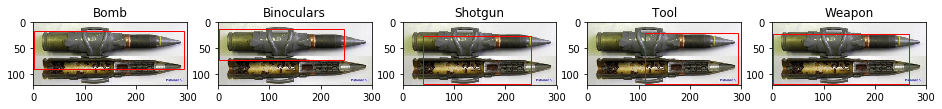

IC0011X1M.jpg.ldcc


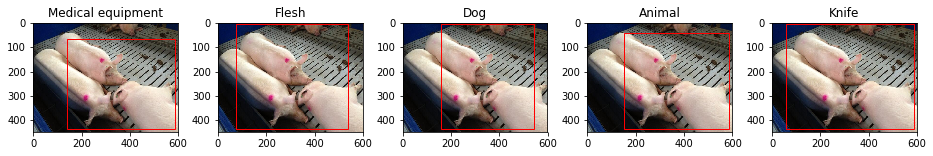

IC00158AG.jpg.ldcc


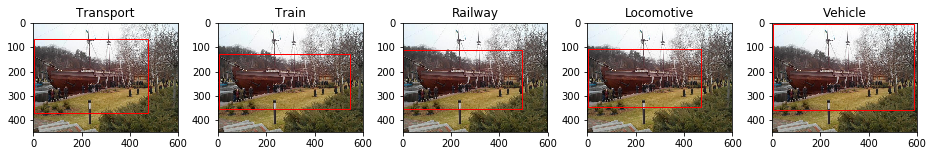

IC0011Z9U.jpg.ldcc


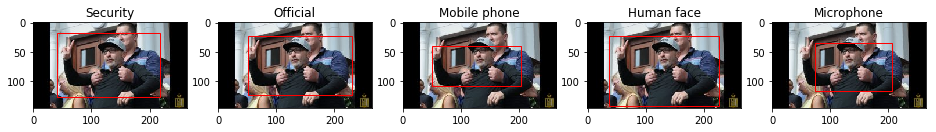

IC0011Z18.jpg.ldcc


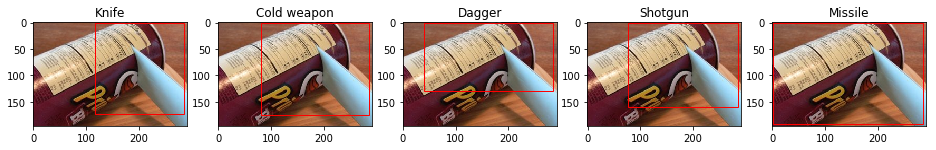

IC0011XLB.jpg.ldcc


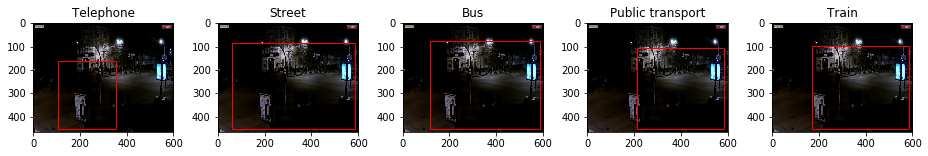

IC0011SIT.jpg.ldcc


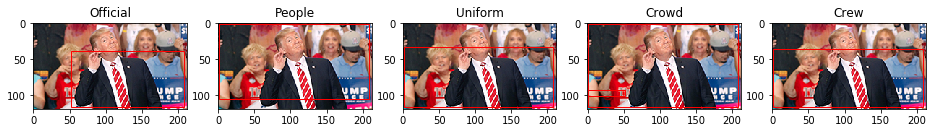

IC0011TAM.jpg.ldcc


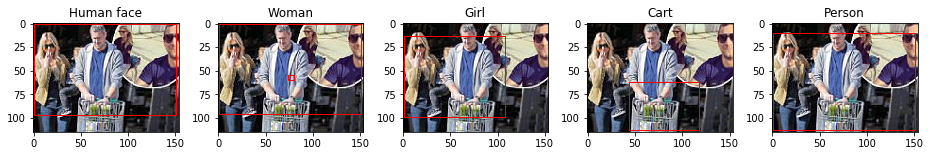

IC0011TMS.jpg.ldcc


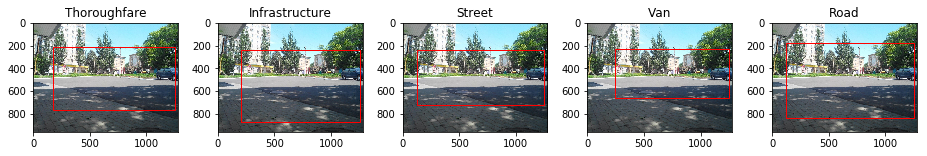

IC0011YU0.jpg.ldcc


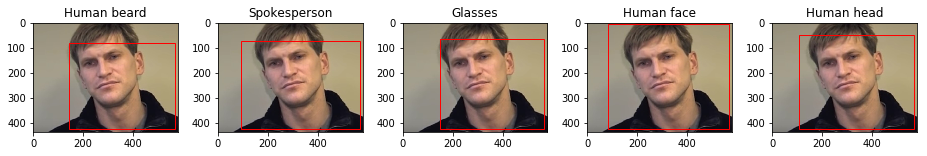

IC0011U13.jpg.ldcc


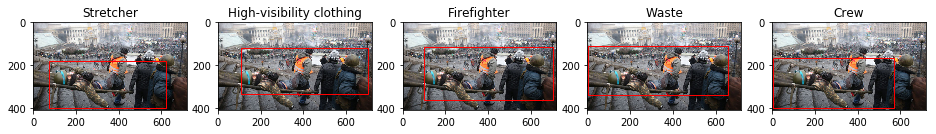

IC0011V7V.jpg.ldcc


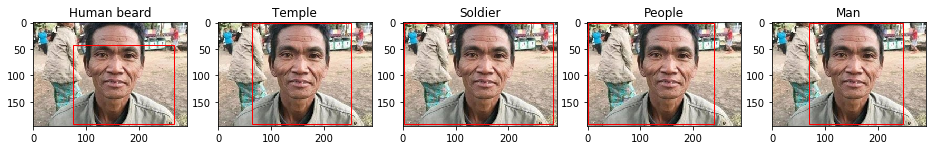

IC0011U52.jpg.ldcc


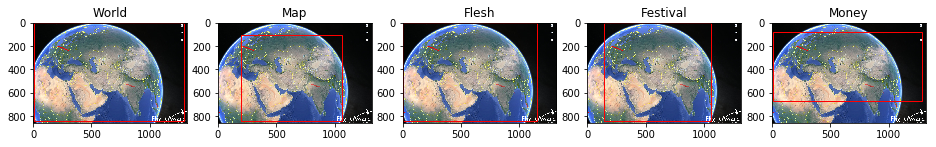

IC0011VAP.jpg.ldcc


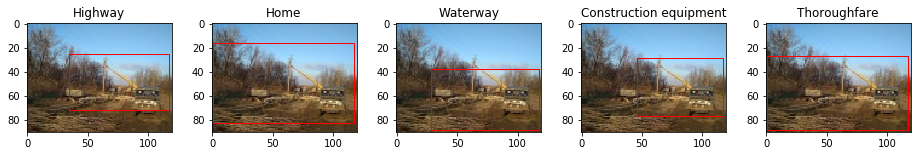

IC0011V8C.jpg.ldcc


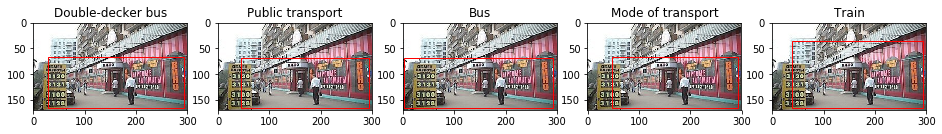

IC00150I4.jpg.ldcc


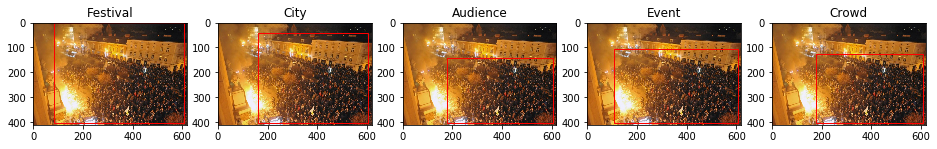

IC0011XUK.jpg.ldcc


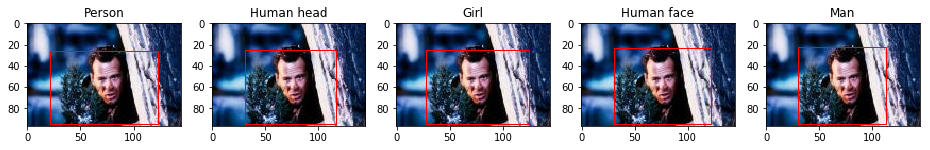

IC0011Y3D.jpg.ldcc


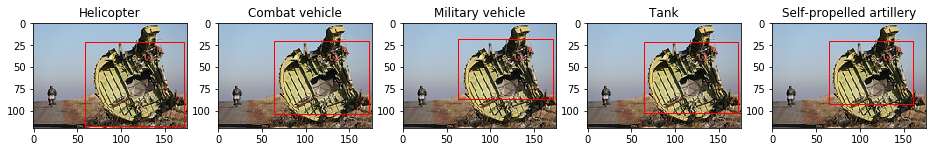

HC000SYCR.jpg.ldcc


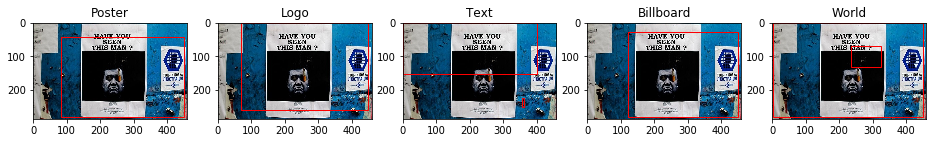

IC00150I0.jpg.ldcc


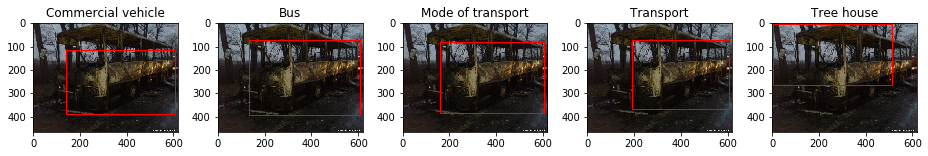

IC0011VR7.jpg.ldcc


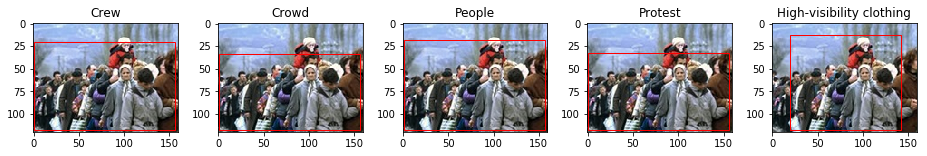

HC000ZJIK.jpg.ldcc


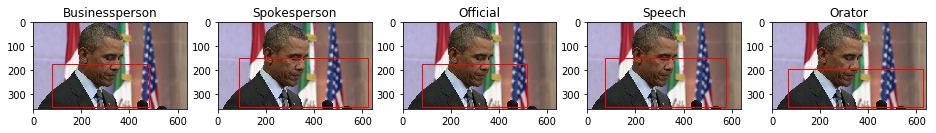

IC0011VZ6.jpg.ldcc


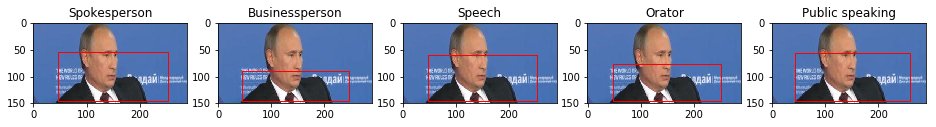

IC0011UG5.jpg.ldcc


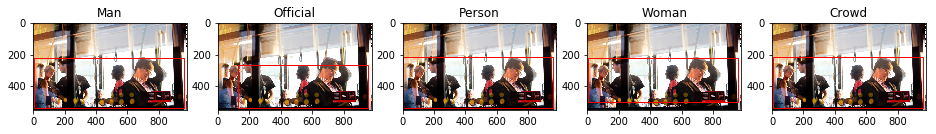

IC0011VWI.jpg.ldcc


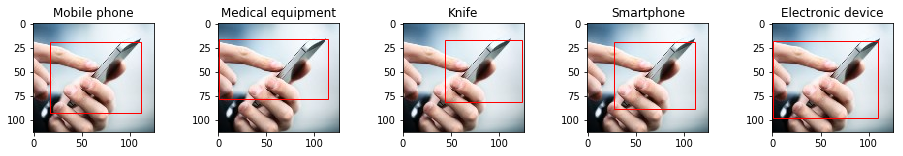

HC000SOSI.jpg.ldcc


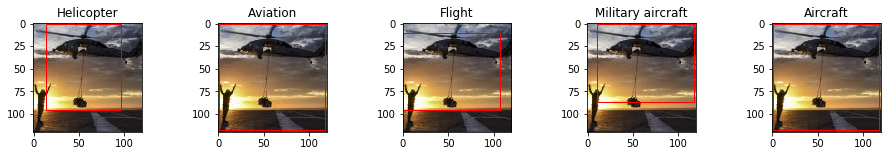

IC0011WXU.jpg.ldcc


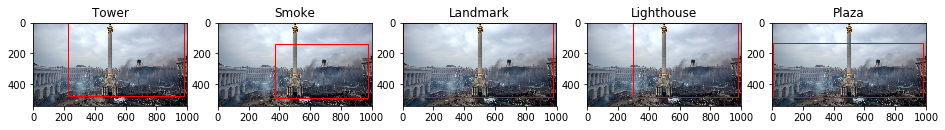

HC00009ZC.jpg.ldcc


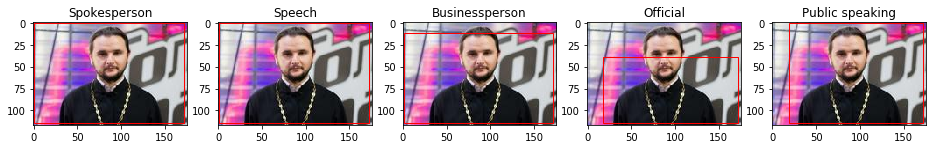

IC0011TON.jpg.ldcc


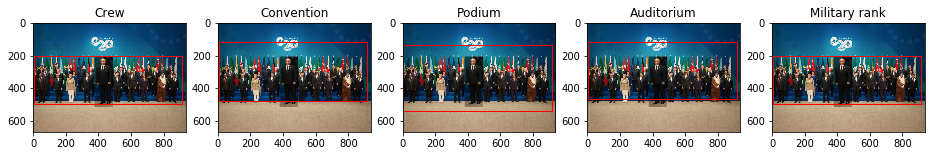

HC00000U6.jpg.ldcc


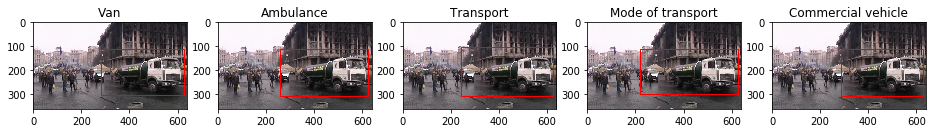

IC0011WJ3.jpg.ldcc


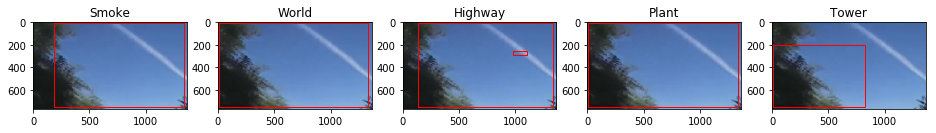

IC0011ZA4.jpg.ldcc


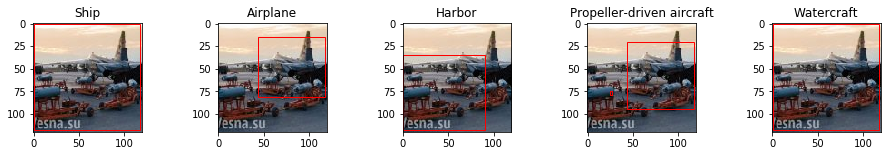

IC0011TAK.jpg.ldcc


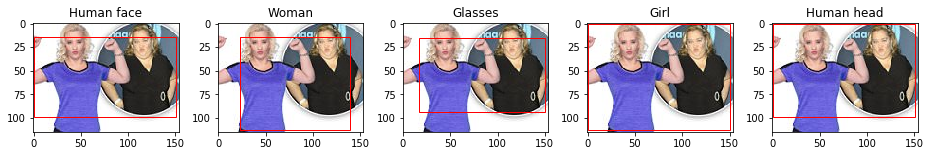

IC0011T9O.jpg.ldcc


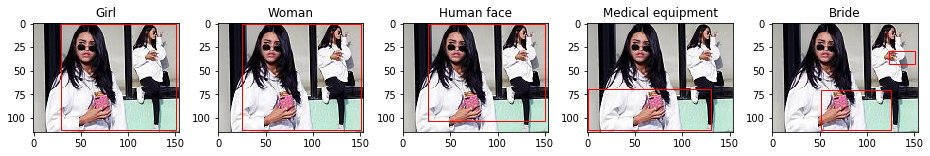

HC000SP9A.jpg.ldcc


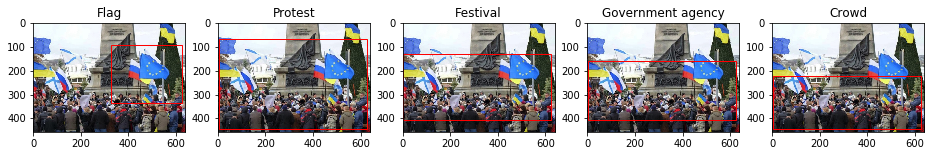

IC0011T81.jpg.ldcc


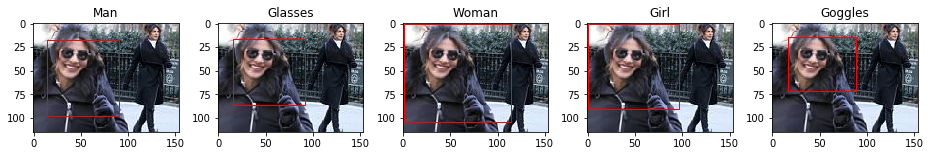

IC0011XN0.jpg.ldcc


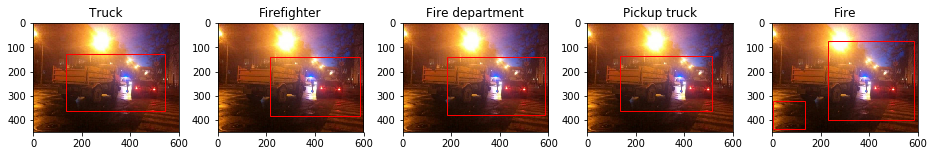

In [22]:
topk_vis = 5
for _ in range(50):
    filename = np.random.choice(test_img_filenames)
    imgid = filename.split('/')[-1]
    print(imgid)
    with open(filename, 'rb') as fin:
        _ = fin.read(1024)
        imgbin = fin.read()
    imgbgr = cv2.imdecode(np.fromstring(imgbin, dtype='uint8'), cv2.IMREAD_COLOR)
    imgrgb = imgbgr[:,:,[2,1,0]]        
    height, width, _ = imgrgb.shape

    #print([mid2name[item['label']] for item in annot[imgid]]) 
    
    fig, axes = plt.subplots(1, topk_vis, figsize=(16, 2))        
    
    for ii in range(topk_vis):
        axes[ii].imshow(imgrgb)
        axes[ii].set_title(mid2name[all_labels[det_results[imgid]['sorted_labels'][ii]]])
        for box in det_results[imgid]['sorted_bboxes'][ii][1::2]:
            axes[ii].add_patch(patches.Rectangle(
                (box[0]*width, box[1]*height), (box[2]-box[0])*width, (box[3]-box[1])*height,
                linewidth=1, edgecolor='r', facecolor='none'
            ))
            
    plt.show()

HC000Q8JS.jpg.ldcc


/home/alireza/home_at_filer2/tools/anaconda3/envs/py3torch/lib/python3.6/site-packages/ipykernel/__main__.py:9: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


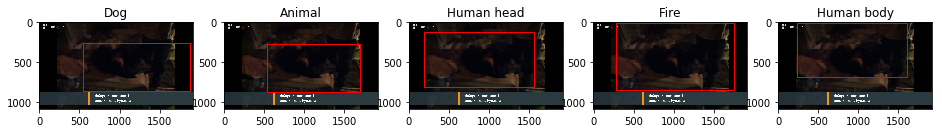

IC0011UNQ.jpg.ldcc


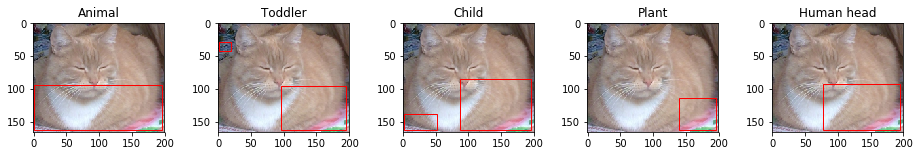

IC0011UHX.jpg.ldcc


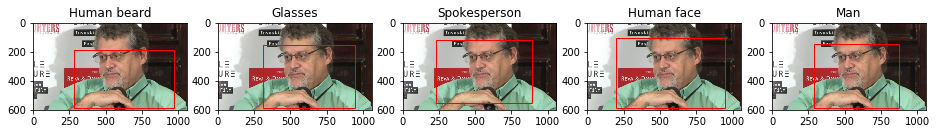

IC0011UQ1.jpg.ldcc


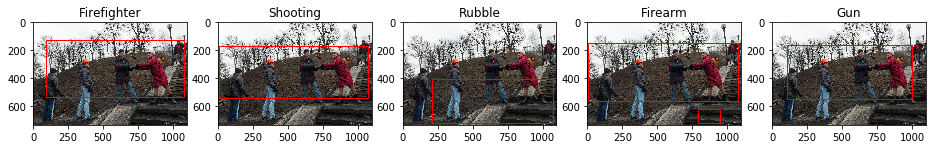

HC000SS1G.jpg.ldcc


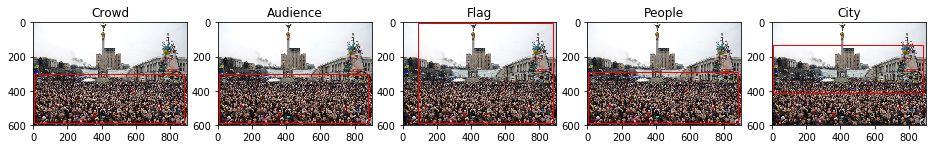

IC00120IU.jpg.ldcc


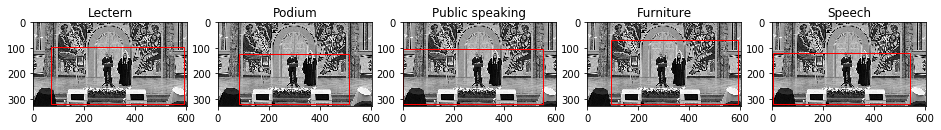

HC000SS15.jpg.ldcc


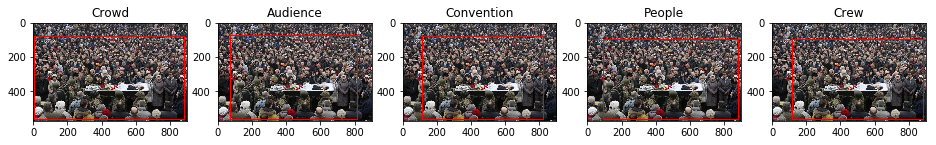

IC00120XO.jpg.ldcc


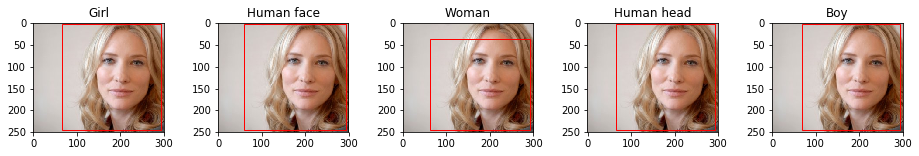

HC000ZJNI.jpg.ldcc


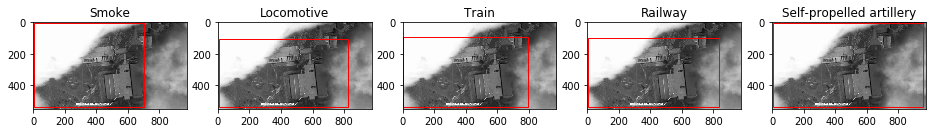

IC0011V1G.jpg.ldcc


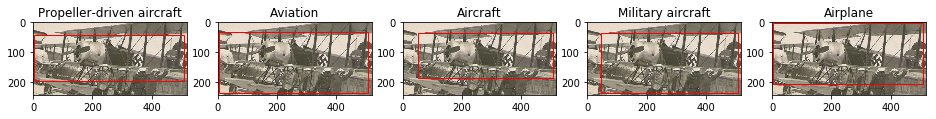

IC0011ZAA.jpg.ldcc


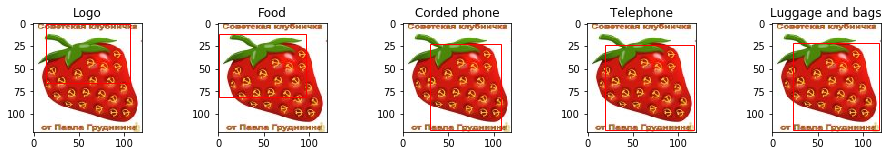

HC000SPMR.jpg.ldcc


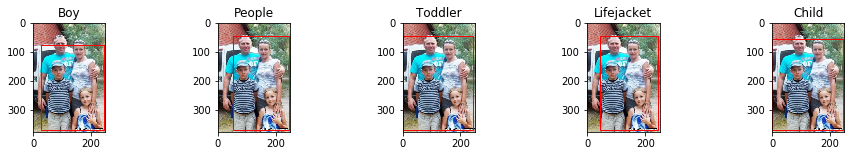

HC000SRYF.jpg.ldcc


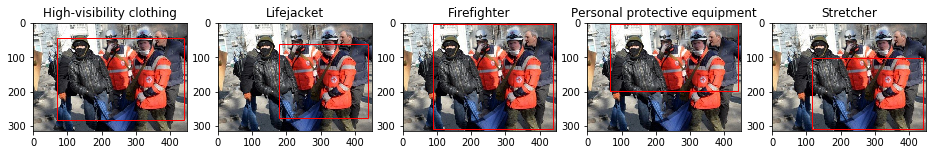

IC0011TT3.jpg.ldcc


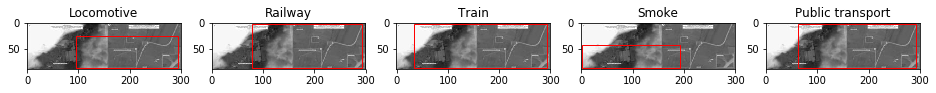

IC00120YT.jpg.ldcc


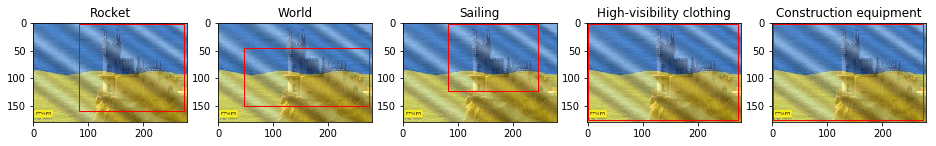

HC000SOID.jpg.ldcc


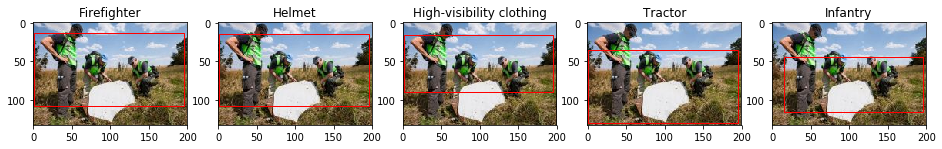

IC0011V1D.jpg.ldcc


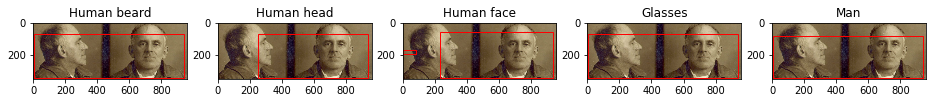

IC0011VIO.jpg.ldcc


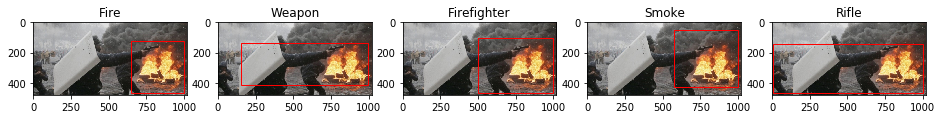

IC00120XG.jpg.ldcc


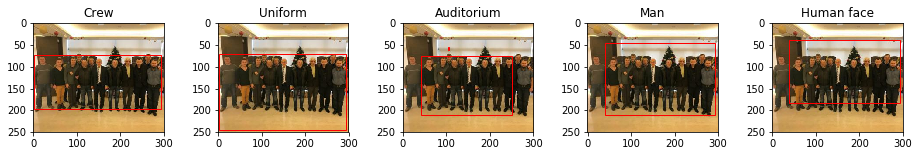

IC001203I.jpg.ldcc


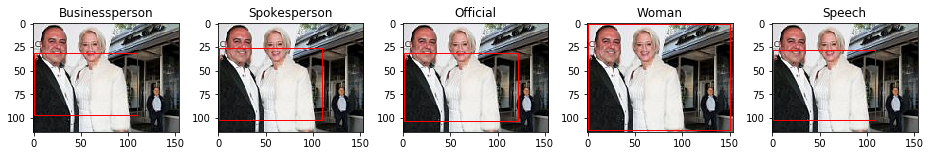

IC0011X1Q.jpg.ldcc


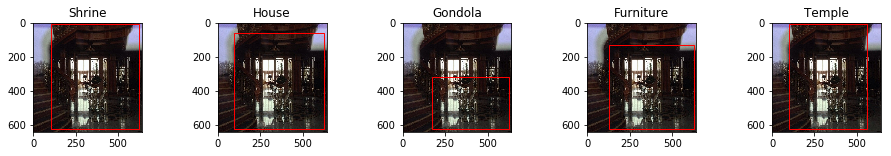

IC0011XMQ.jpg.ldcc


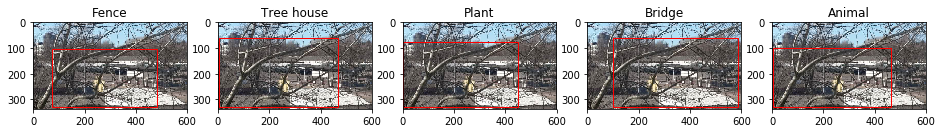

IC0011U84.jpg.ldcc


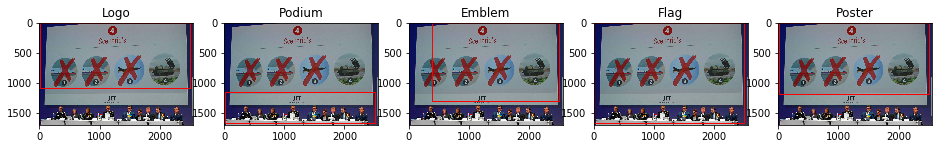

IC0011W09.jpg.ldcc


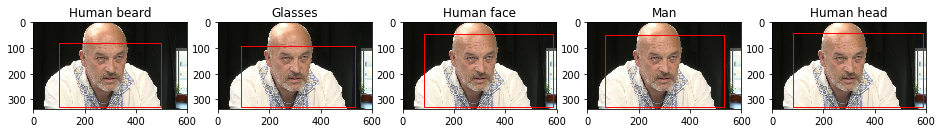

IC0011W52.jpg.ldcc


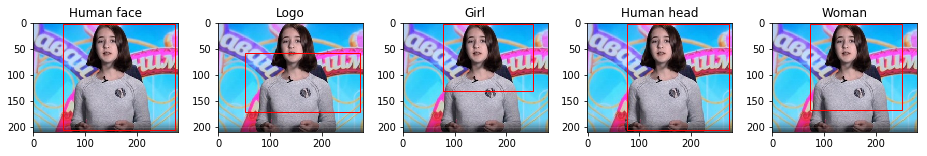

IC0011VOU.jpg.ldcc


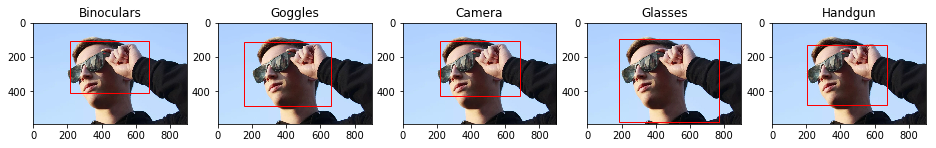

IC0011UH1.jpg.ldcc


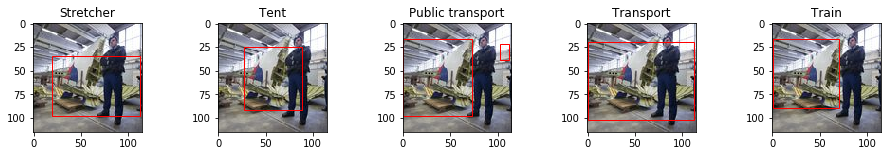

HC00025EE.jpg.ldcc


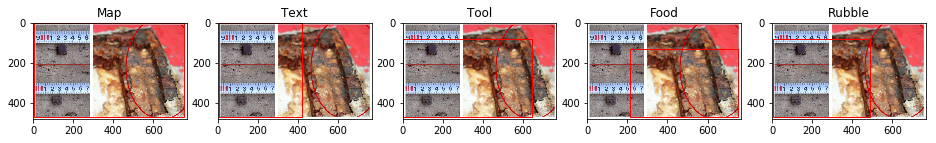

IC0011UEU.jpg.ldcc


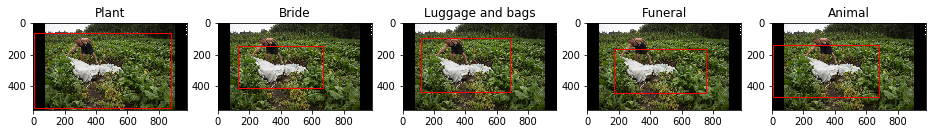

IC0011WHT.jpg.ldcc


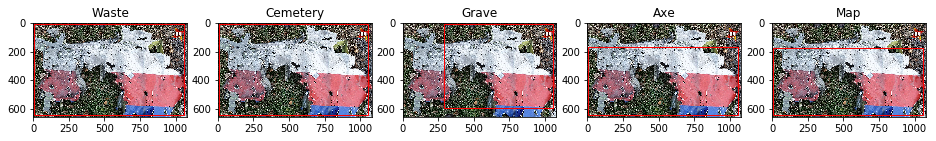

HC000ZJHS.jpg.ldcc


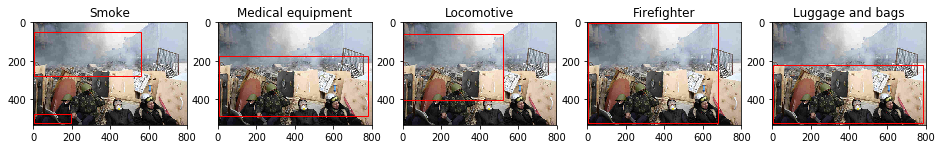

HC00000QP.jpg.ldcc


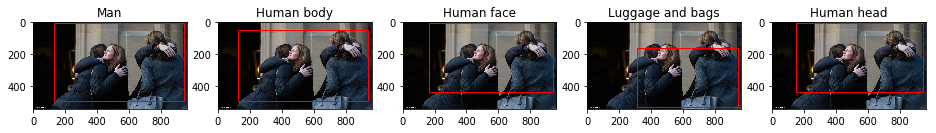

HC000ZIZC.jpg.ldcc


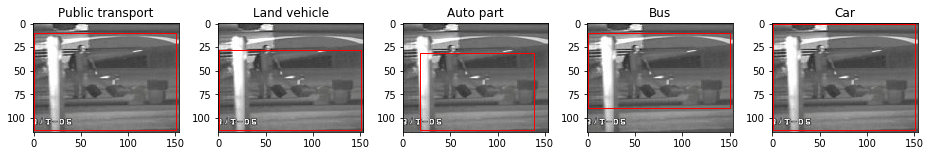

IC0014WH0.jpg.ldcc


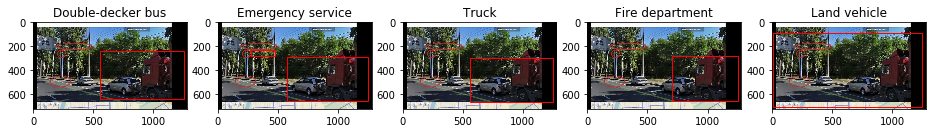

IC0011U3V.jpg.ldcc


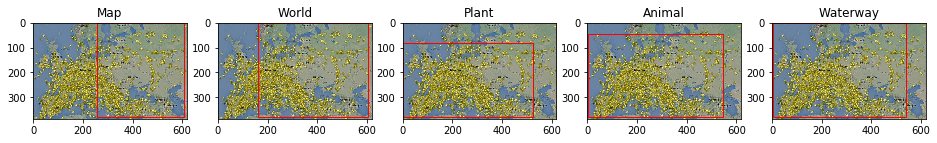

IC0011XIL.jpg.ldcc


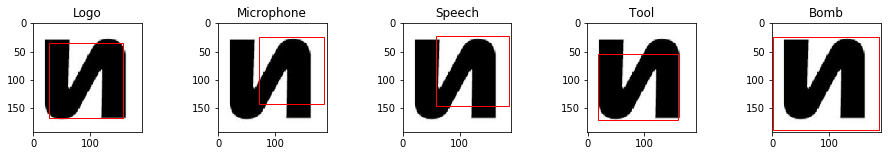

IC0011VI2.jpg.ldcc


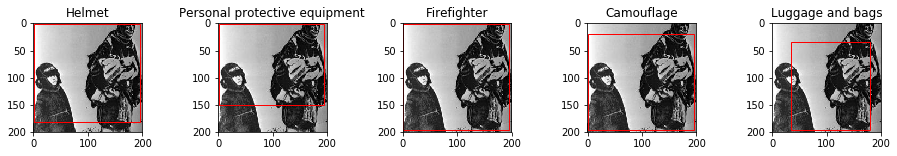

HC000SY3H.jpg.ldcc


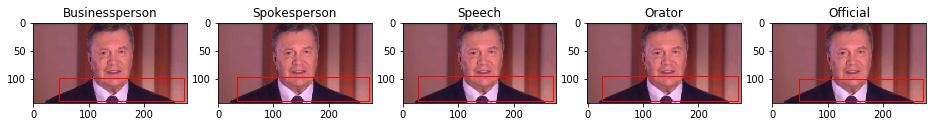

IC0011SIU.jpg.ldcc


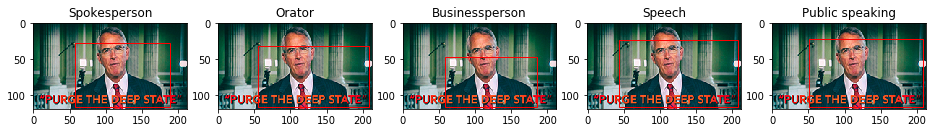

HC000Q8OF.jpg.ldcc


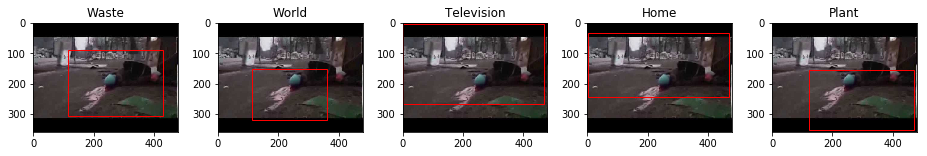

IC00121K9.jpg.ldcc


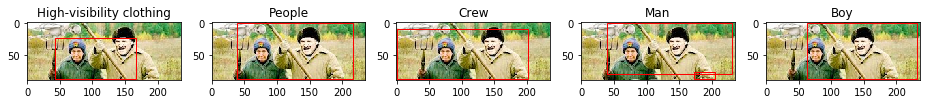

IC0011UXM.jpg.ldcc


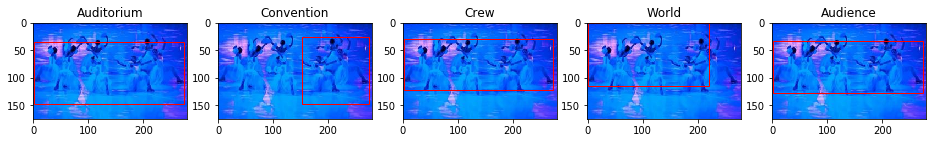

HC00025FM.jpg.ldcc


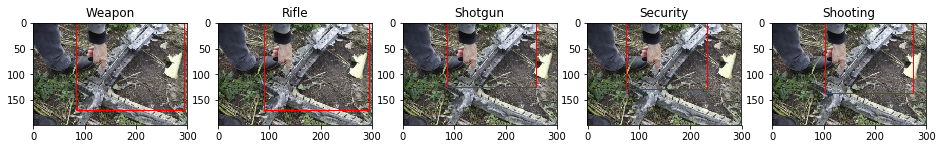

IC001203C.jpg.ldcc


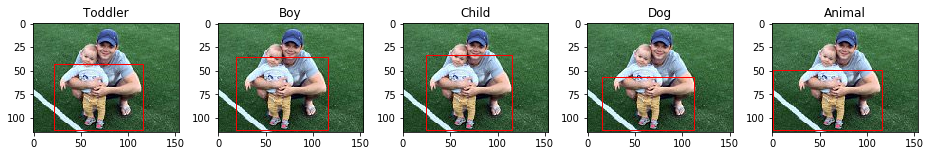

IC0011XN3.jpg.ldcc


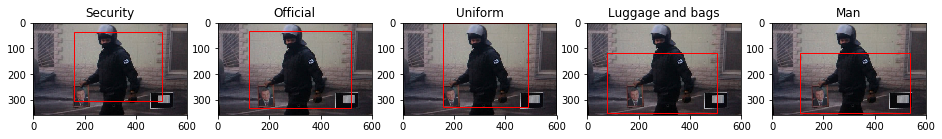

IC0011UG7.jpg.ldcc


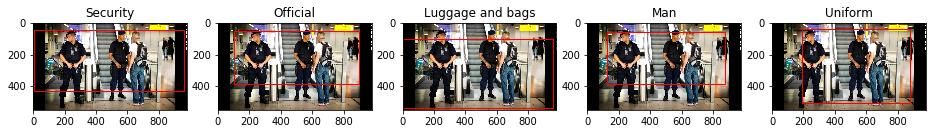

HC000SUOR.jpg.ldcc


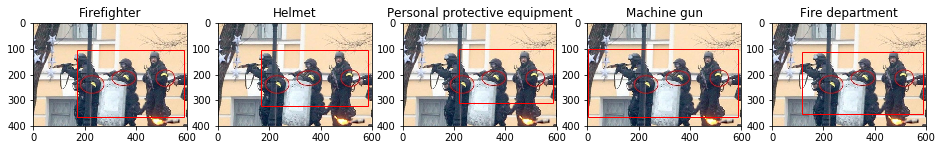

IC0011T2S.jpg.ldcc


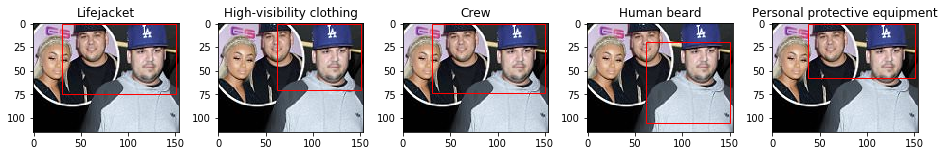

IC0011V5S.jpg.ldcc


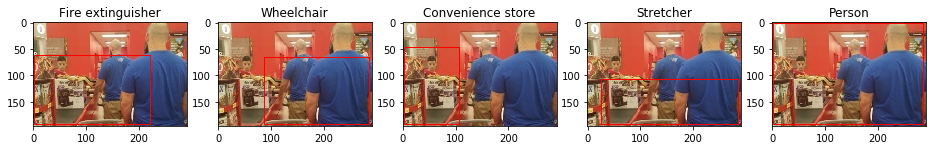

IC0011VWF.jpg.ldcc


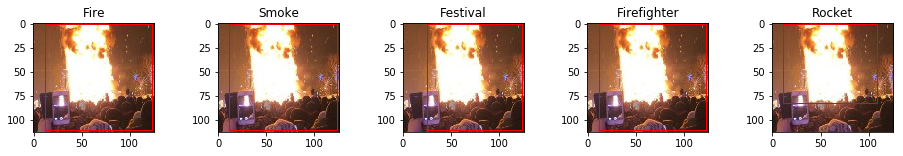

In [23]:
topk_vis = 5
for _ in range(50):
    filename = np.random.choice(test_img_filenames)
    imgid = filename.split('/')[-1]
    print(imgid)
    with open(filename, 'rb') as fin:
        _ = fin.read(1024)
        imgbin = fin.read()
    imgbgr = cv2.imdecode(np.fromstring(imgbin, dtype='uint8'), cv2.IMREAD_COLOR)
    imgrgb = imgbgr[:,:,[2,1,0]]        
    height, width, _ = imgrgb.shape

    #print([mid2name[item['label']] for item in annot[imgid]]) 
    
    fig, axes = plt.subplots(1, topk_vis, figsize=(16, 2))        
    
    for ii in range(topk_vis):
        axes[ii].imshow(imgrgb)
        axes[ii].set_title(mid2name[all_labels[det_results[imgid]['sorted_labels'][ii]]])
        for box in det_results[imgid]['sorted_bboxes'][ii][1::2]:
            axes[ii].add_patch(patches.Rectangle(
                (box[0]*width, box[1]*height), (box[2]-box[0])*width, (box[3]-box[1])*height,
                linewidth=1, edgecolor='r', facecolor='none'
            ))
            
    plt.show()

IC0011T39.jpg.ldcc


/home/alireza/home_at_filer2/tools/anaconda3/envs/py3torch/lib/python3.6/site-packages/ipykernel/__main__.py:9: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


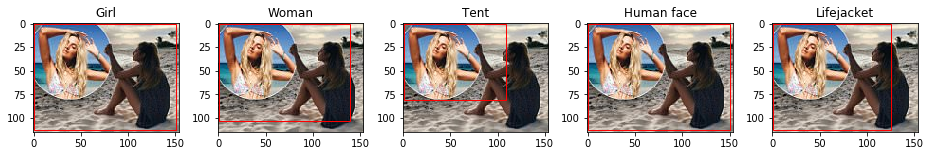

IC0011UFH.jpg.ldcc


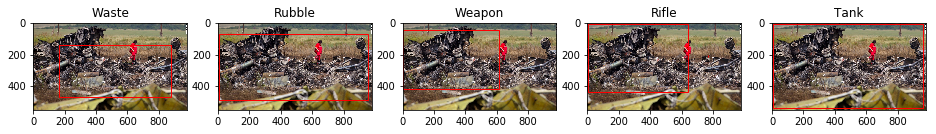

HC000SS1E.jpg.ldcc


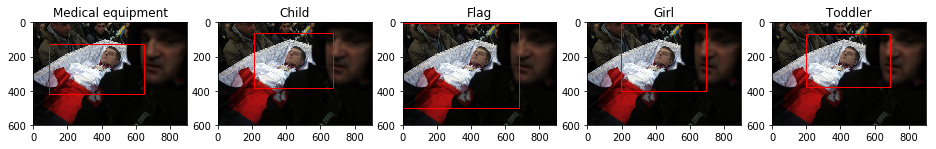

IC0011X0R.jpg.ldcc


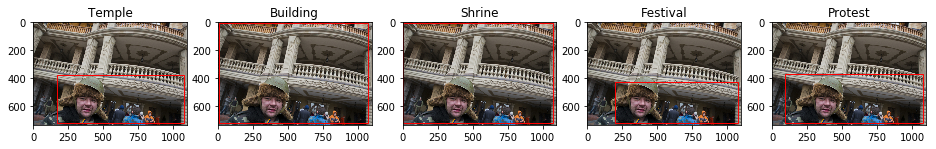

HC000ZKFV.jpg.ldcc


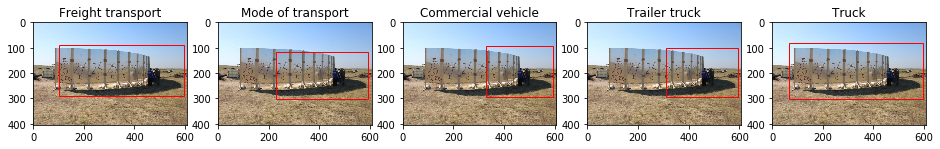

IC0011T4D.jpg.ldcc


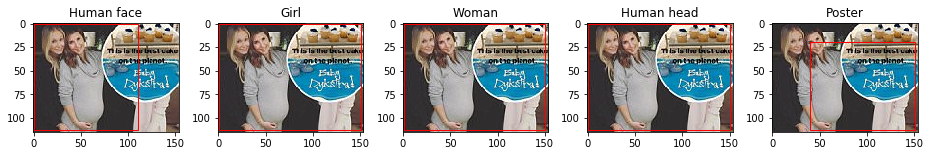

HC000SPNJ.jpg.ldcc


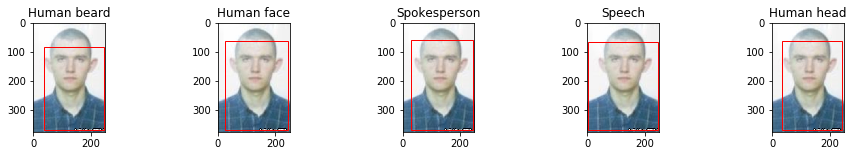

IC0011X6N.jpg.ldcc


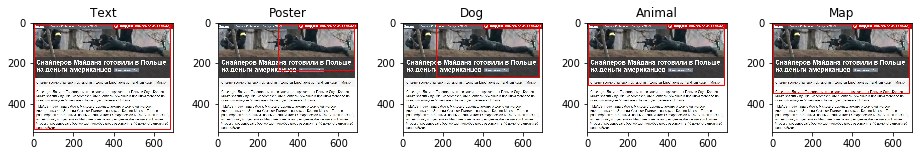

IC0011UQC.jpg.ldcc


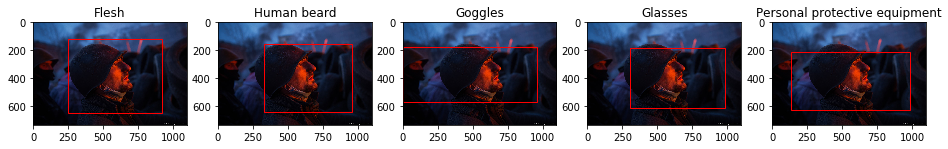

HC00025DP.jpg.ldcc


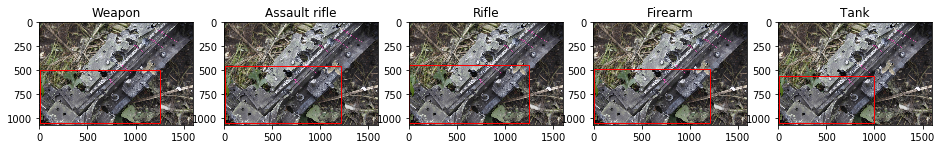

IC00120XT.jpg.ldcc


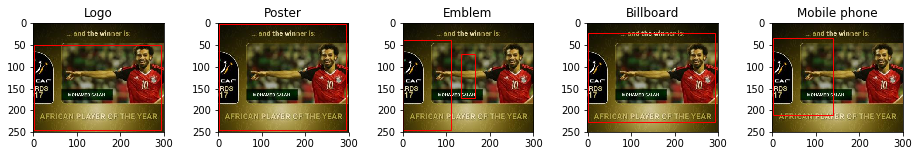

IC0011XS6.jpg.ldcc


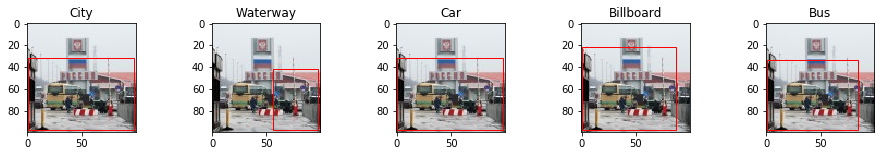

HC000ZIYW.jpg.ldcc


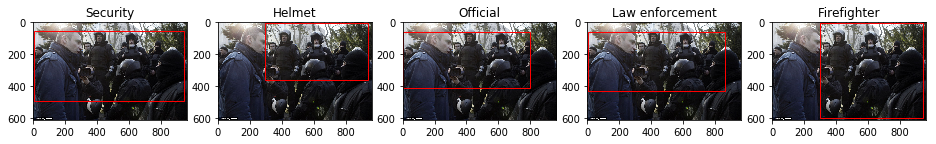

HC000SP4H.jpg.ldcc


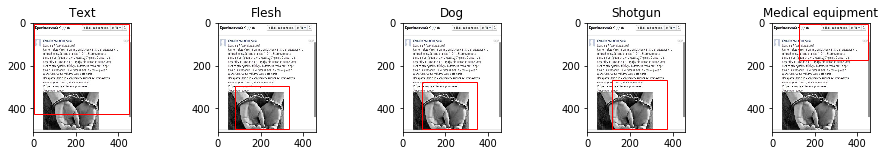

IC0011XGP.jpg.ldcc


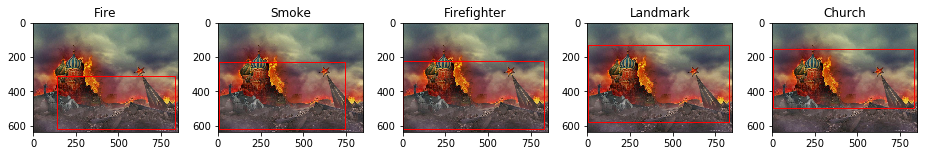

IC0011WSR.jpg.ldcc


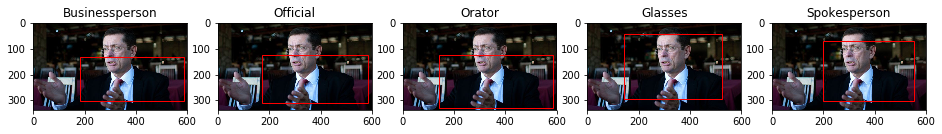

IC0011V7K.jpg.ldcc


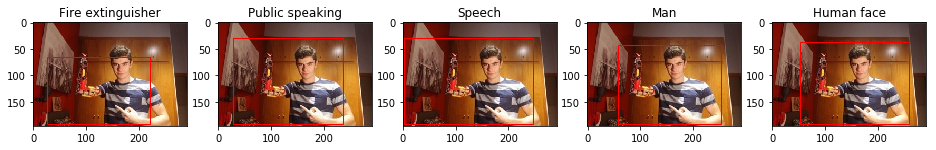

IC0011YIK.jpg.ldcc


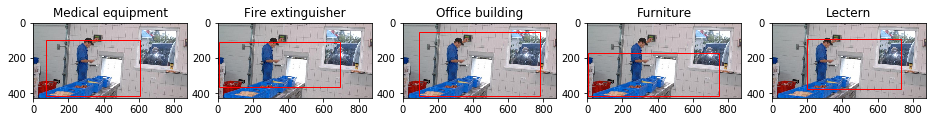

HC000SPNM.jpg.ldcc


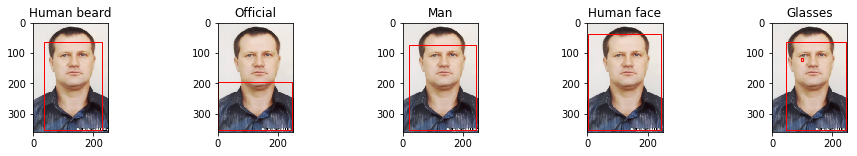

IC0011Z9V.jpg.ldcc


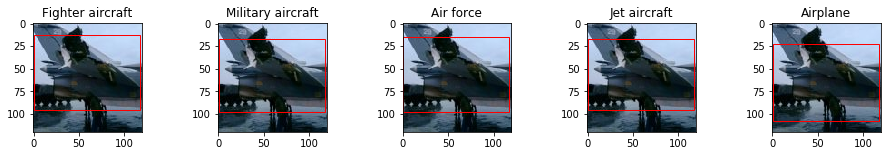

IC0011WKA.jpg.ldcc


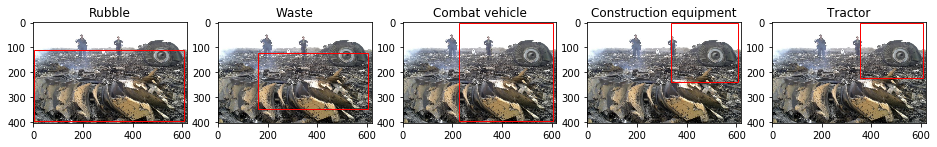

IC0011WG0.jpg.ldcc


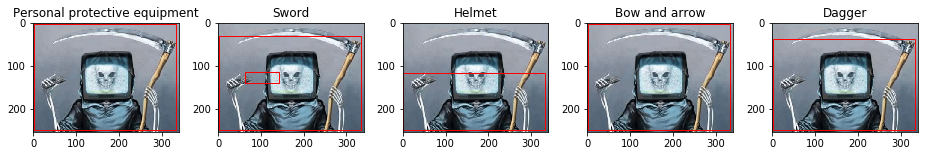

IC0011V2Y.jpg.ldcc


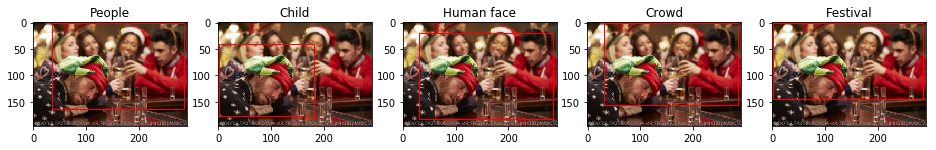

IC0011VRR.jpg.ldcc


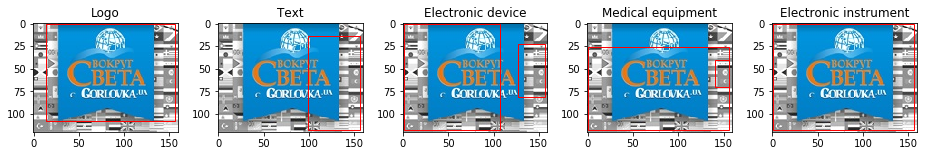

HC00000J9.jpg.ldcc


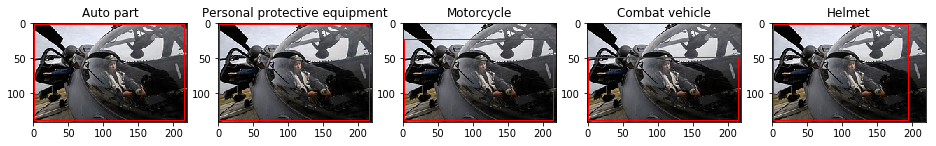

IC0011T5Y.jpg.ldcc


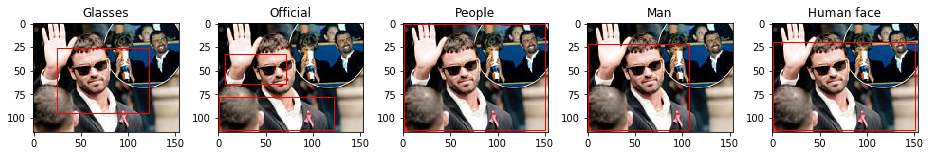

HC000SP94.jpg.ldcc


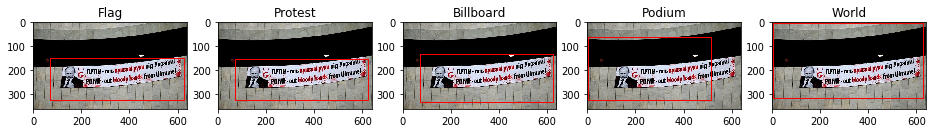

IC0011UQ5.jpg.ldcc


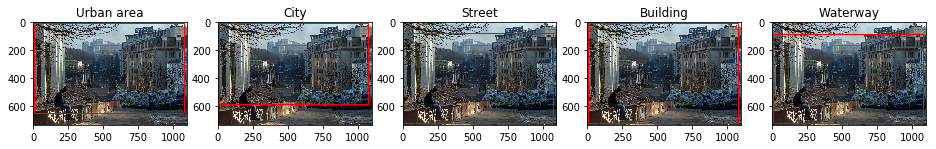

IC0011XQ5.jpg.ldcc


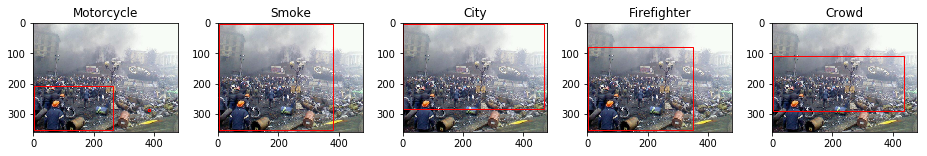

IC0011V3L.jpg.ldcc


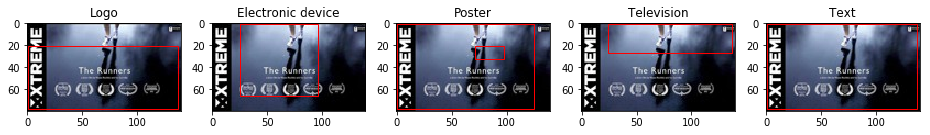

IC0011XGX.jpg.ldcc


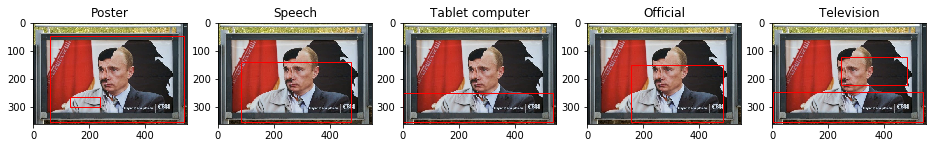

IC00120FZ.jpg.ldcc


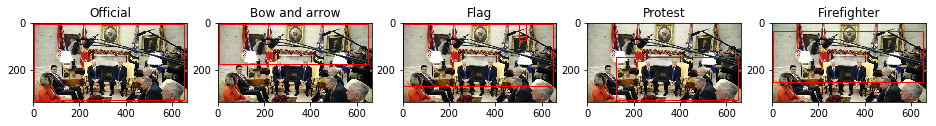

IC0011V68.jpg.ldcc


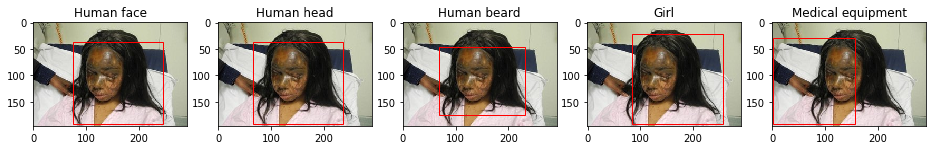

HC00025FS.jpg.ldcc


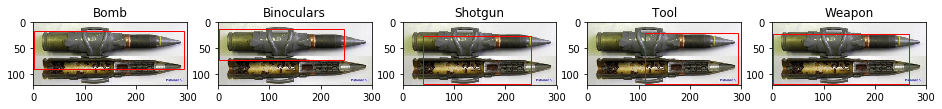

IC0011T1V.jpg.ldcc


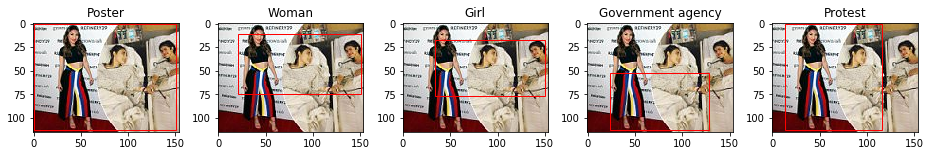

IC0011SJ5.jpg.ldcc


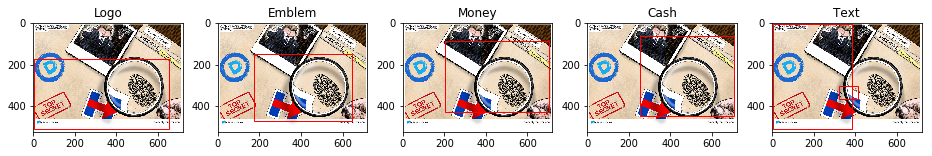

IC0011VZY.jpg.ldcc


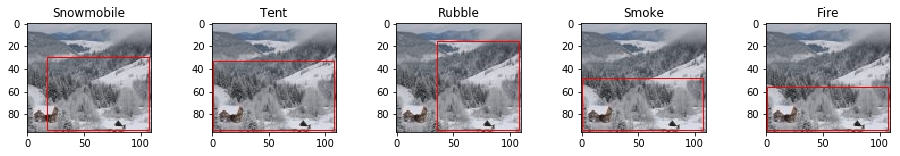

IC0011UPL.jpg.ldcc


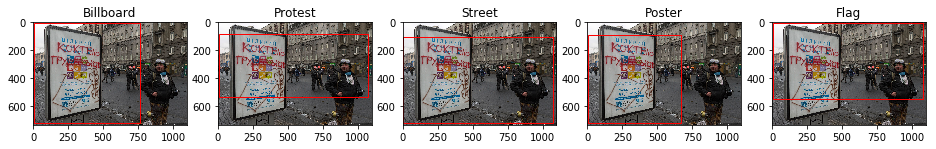

IC0011TB8.jpg.ldcc


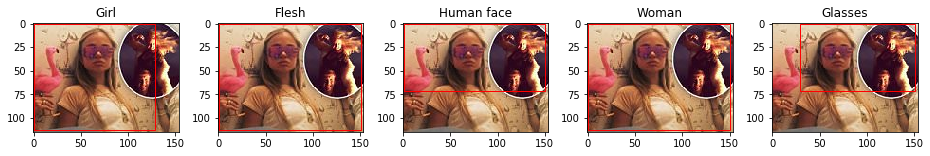

IC0011Y9D.jpg.ldcc


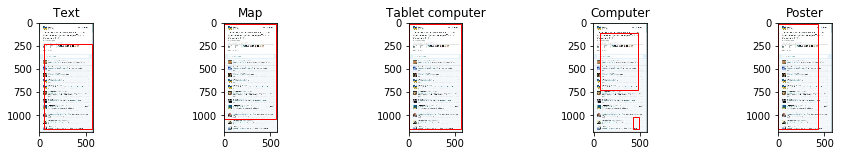

IC00150B4.jpg.ldcc


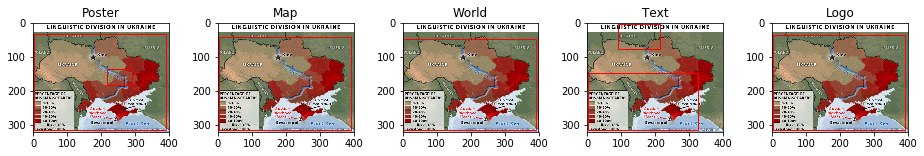

HC000SP4W.jpg.ldcc


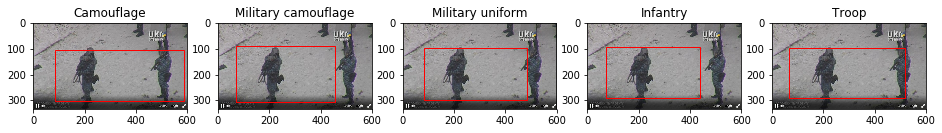

IC0011XI6.jpg.ldcc


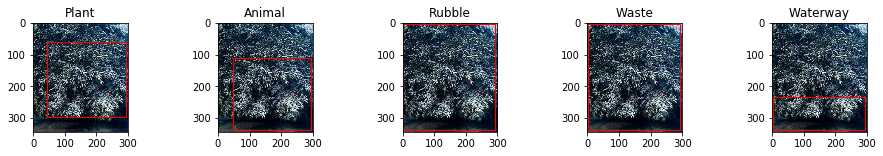

IC001203S.jpg.ldcc


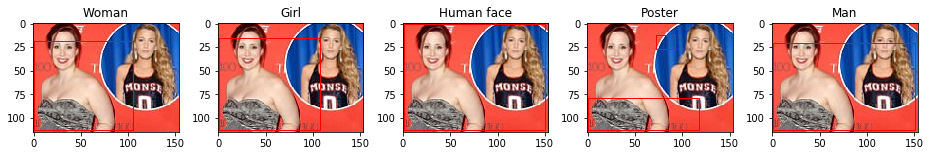

IC001203F.jpg.ldcc


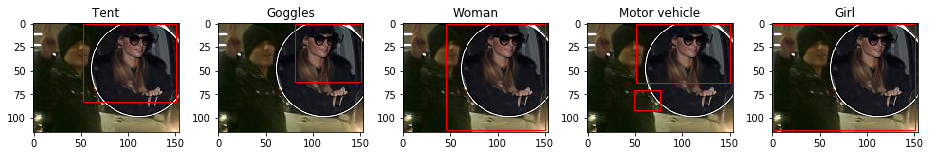

IC0011XU9.jpg.ldcc


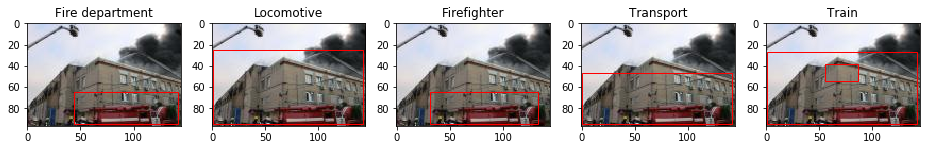

IC0011XMH.jpg.ldcc


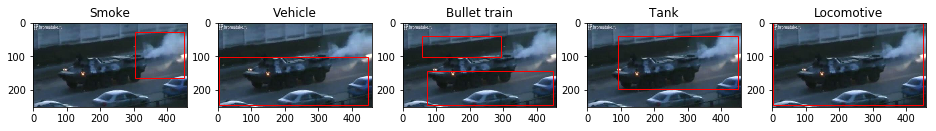

IC0011V7H.jpg.ldcc


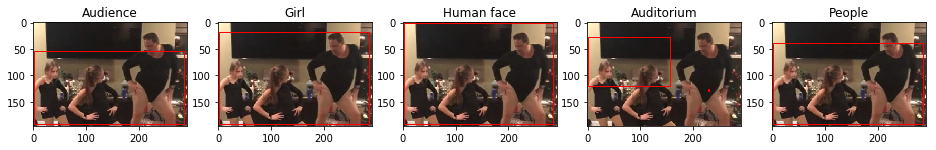

IC0011V5K.jpg.ldcc


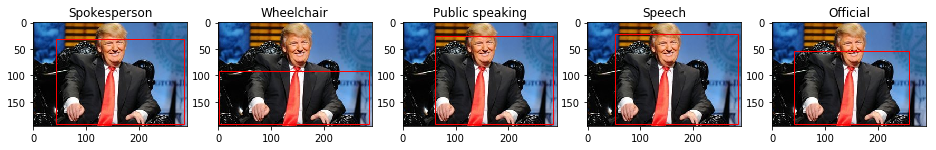

HC000SYDP.jpg.ldcc


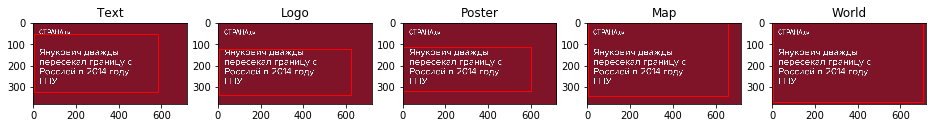

In [24]:
topk_vis = 5
for _ in range(50):
    filename = np.random.choice(test_img_filenames)
    imgid = filename.split('/')[-1]
    print(imgid)
    with open(filename, 'rb') as fin:
        _ = fin.read(1024)
        imgbin = fin.read()
    imgbgr = cv2.imdecode(np.fromstring(imgbin, dtype='uint8'), cv2.IMREAD_COLOR)
    imgrgb = imgbgr[:,:,[2,1,0]]        
    height, width, _ = imgrgb.shape

    #print([mid2name[item['label']] for item in annot[imgid]]) 
    
    fig, axes = plt.subplots(1, topk_vis, figsize=(16, 2))        
    
    for ii in range(topk_vis):
        axes[ii].imshow(imgrgb)
        axes[ii].set_title(mid2name[all_labels[det_results[imgid]['sorted_labels'][ii]]])
        for box in det_results[imgid]['sorted_bboxes'][ii][1::2]:
            axes[ii].add_patch(patches.Rectangle(
                (box[0]*width, box[1]*height), (box[2]-box[0])*width, (box[3]-box[1])*height,
                linewidth=1, edgecolor='r', facecolor='none'
            ))
            
    plt.show()

IC00120YY.jpg.ldcc


/home/alireza/home_at_filer2/tools/anaconda3/envs/py3torch/lib/python3.6/site-packages/ipykernel/__main__.py:9: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


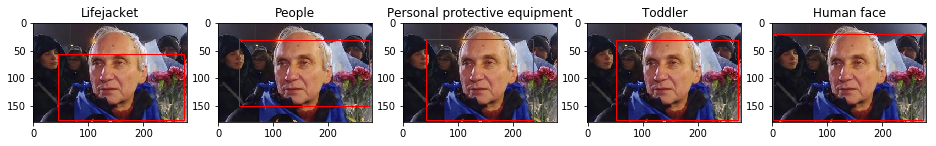

IC0011X0W.jpg.ldcc


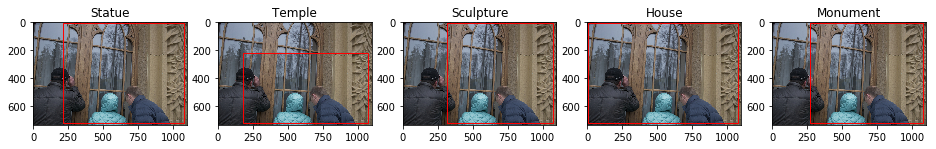

IC0011Z3D.jpg.ldcc


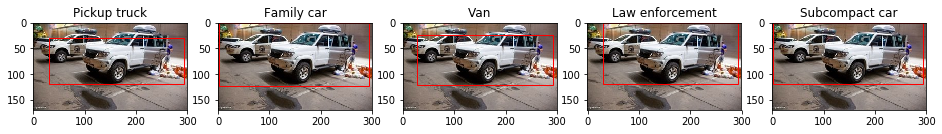

HC000SO9Z.jpg.ldcc


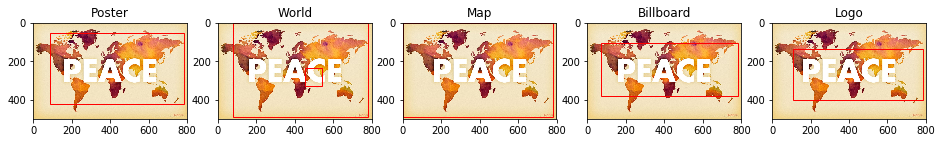

IC0011T5G.jpg.ldcc


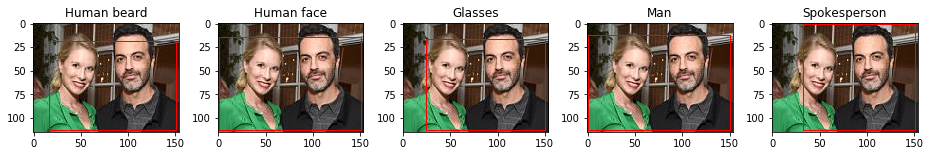

IC0011XGX.jpg.ldcc


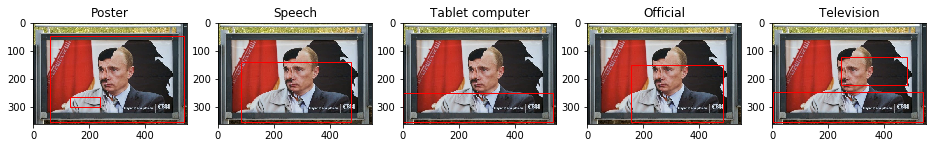

IC0011T67.jpg.ldcc


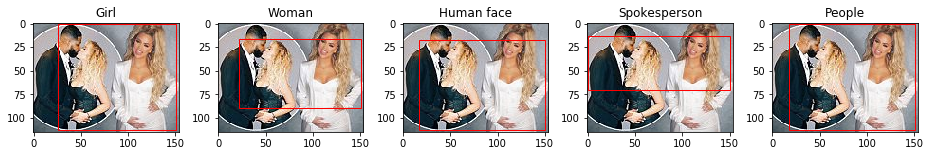

IC0011T98.jpg.ldcc


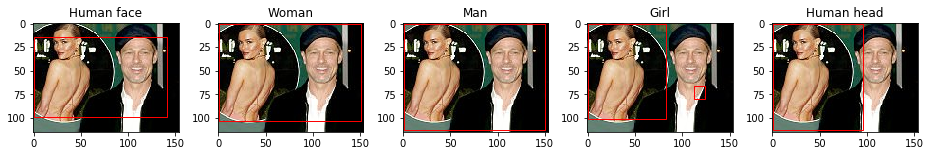

IC0011TD8.jpg.ldcc


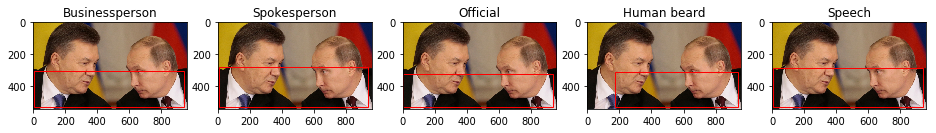

IC0011Z9P.jpg.ldcc


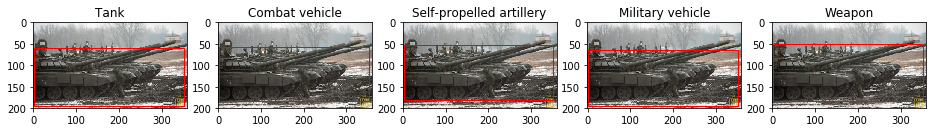

IC0011Z9R.jpg.ldcc


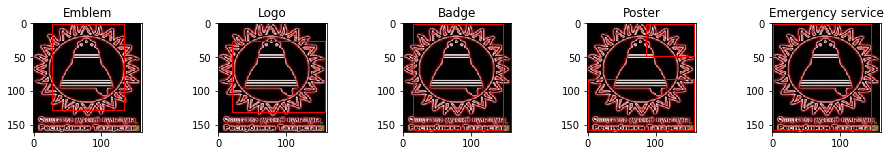

HC000SPMB.jpg.ldcc


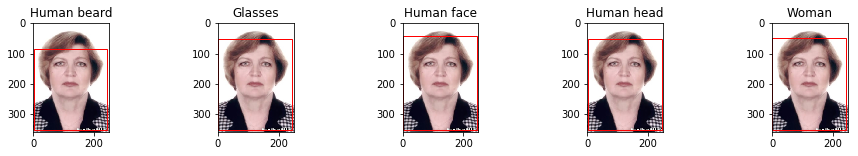

IC0011T23.jpg.ldcc


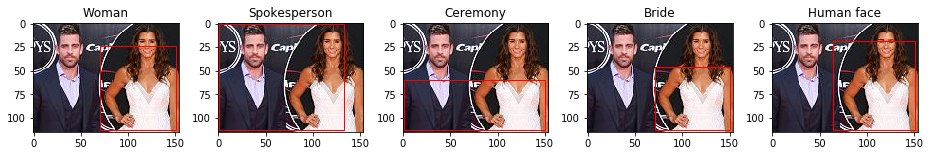

IC0011TPU.jpg.ldcc


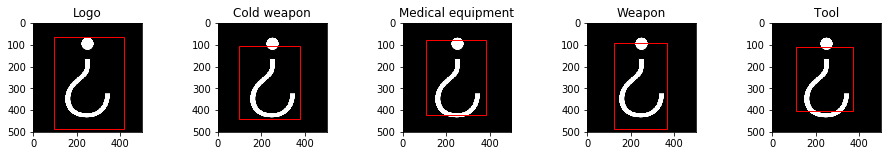

IC0011XL7.jpg.ldcc


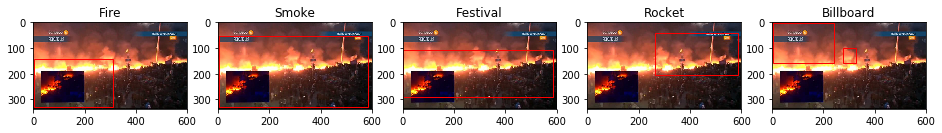

IC0011X9A.jpg.ldcc


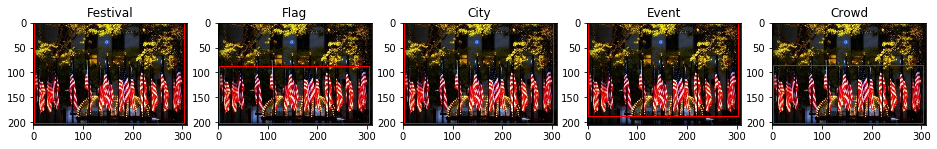

IC00120FK.jpg.ldcc


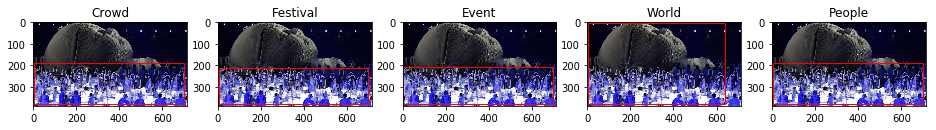

IC0011UER.jpg.ldcc


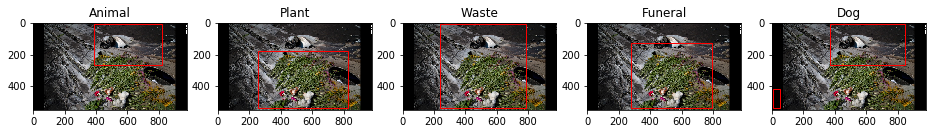

IC0011T5I.jpg.ldcc


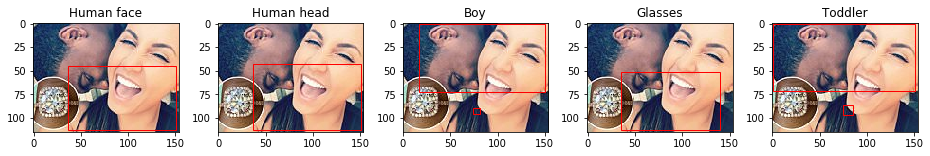

IC0011SXT.jpg.ldcc


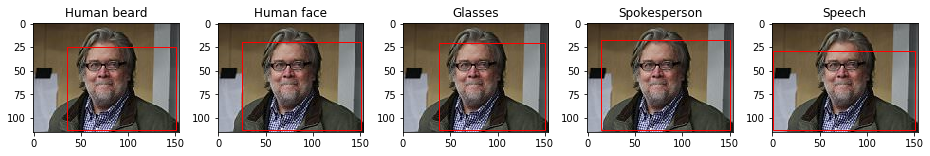

IC0011UMM.jpg.ldcc


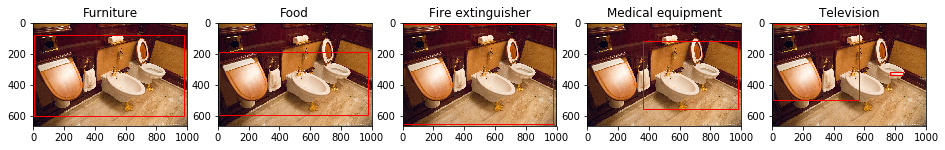

IC0011W3F.jpg.ldcc


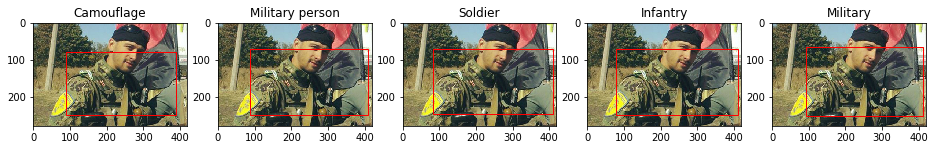

IC00120XI.jpg.ldcc


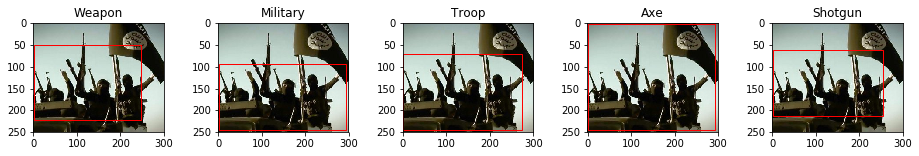

IC0011V6D.jpg.ldcc


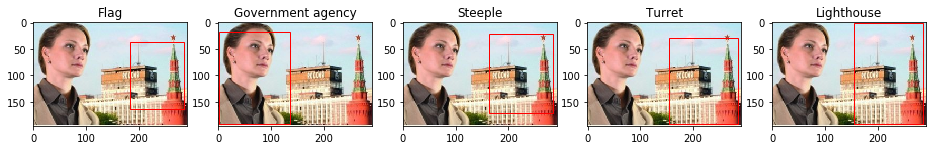

IC0011X3L.jpg.ldcc


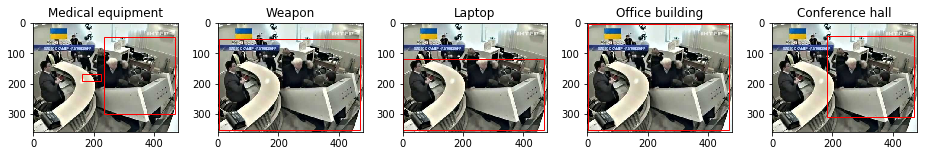

IC0011T4Z.jpg.ldcc


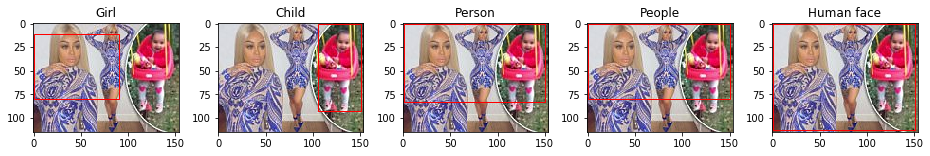

IC0011Z0E.jpg.ldcc


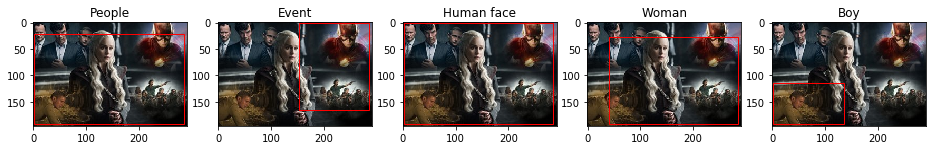

HC000SNJL.jpg.ldcc


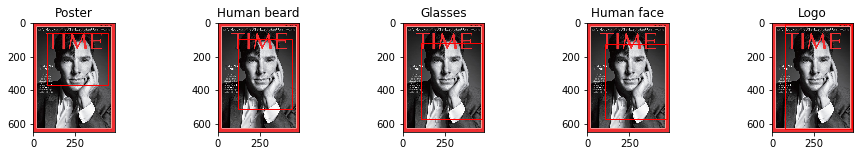

IC0011T1N.jpg.ldcc


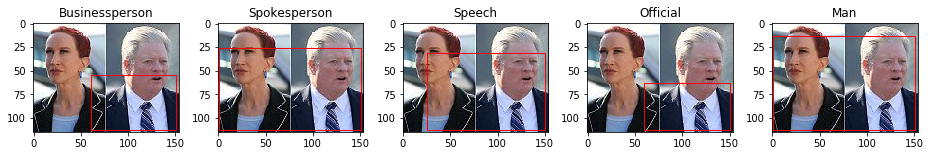

HC00025GJ.jpg.ldcc


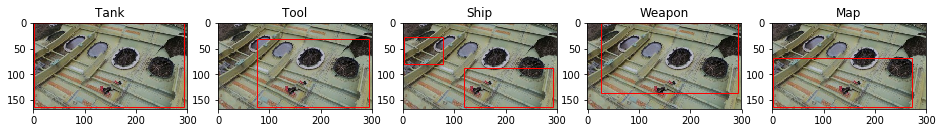

IC00120Y5.jpg.ldcc


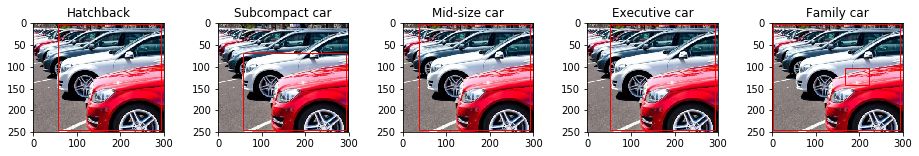

IC0011W8D.jpg.ldcc


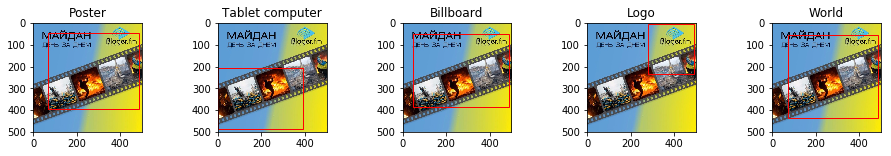

IC0011TD7.jpg.ldcc


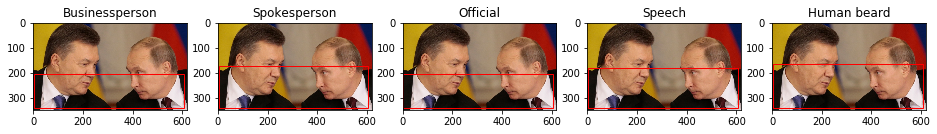

HC000ZJHM.jpg.ldcc


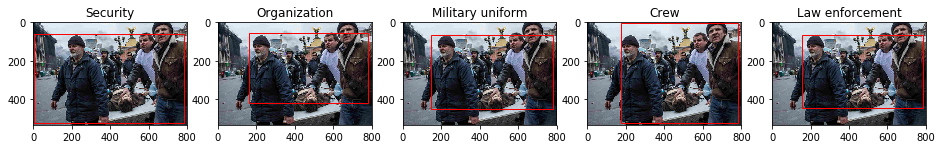

IC0011WQS.jpg.ldcc


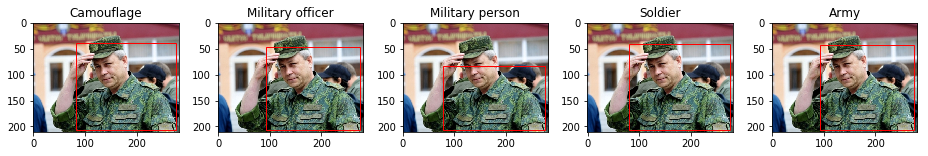

IC0011VC1.jpg.ldcc


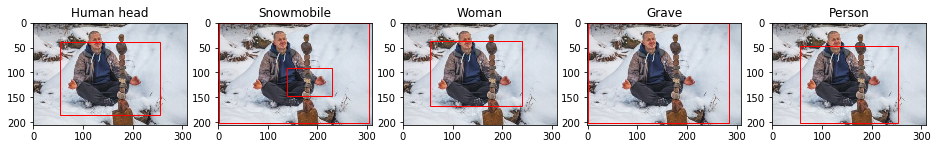

IC0011UM0.jpg.ldcc


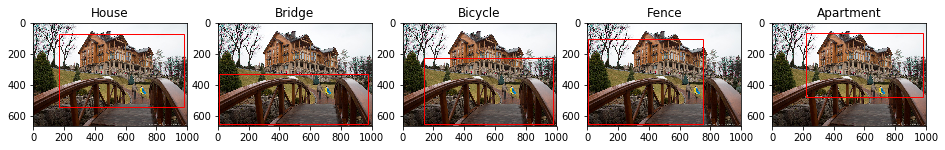

HC00055NT.jpg.ldcc


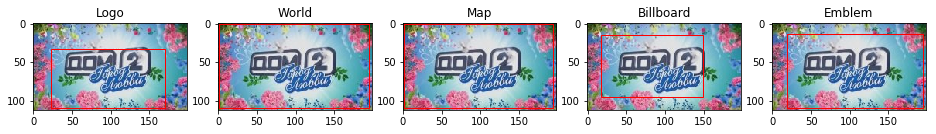

IC0011VOT.jpg.ldcc


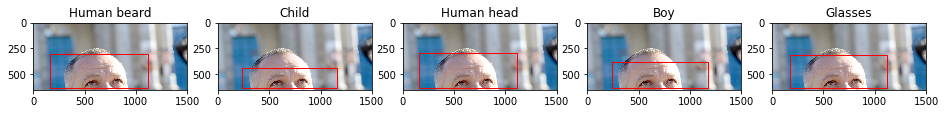

IC0011V0G.jpg.ldcc


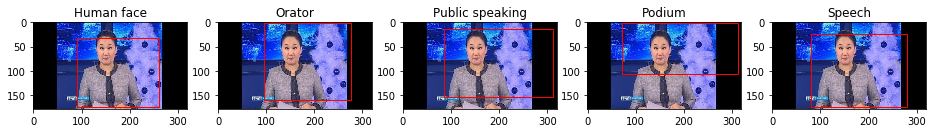

IC0011VRH.jpg.ldcc


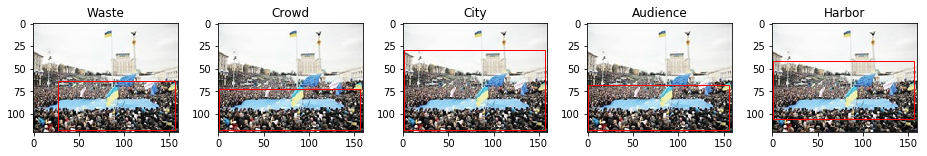

IC0011WQK.jpg.ldcc


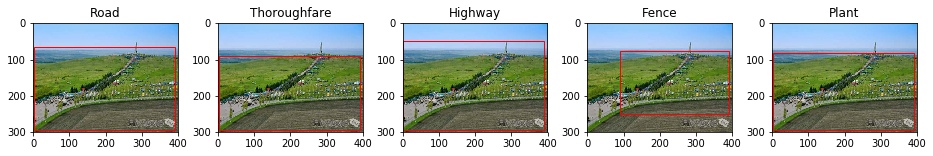

HC000SOQU.jpg.ldcc


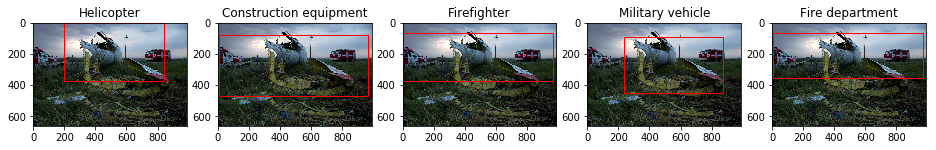

IC0011VRX.jpg.ldcc


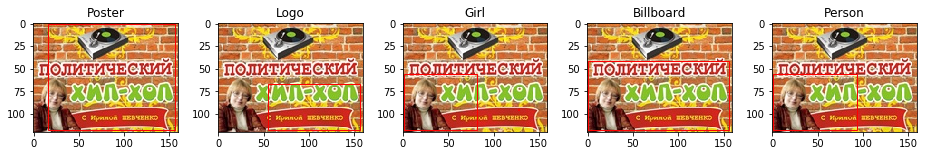

HC000SPM4.jpg.ldcc


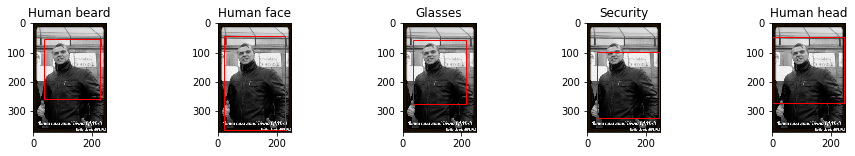

HC000ZIZO.jpg.ldcc


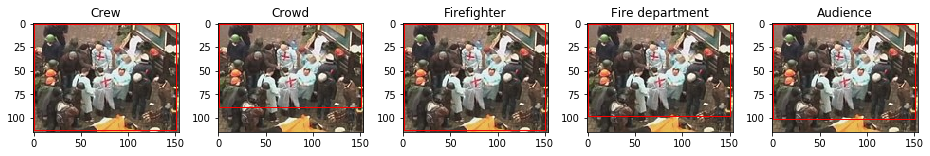

IC001217P.jpg.ldcc


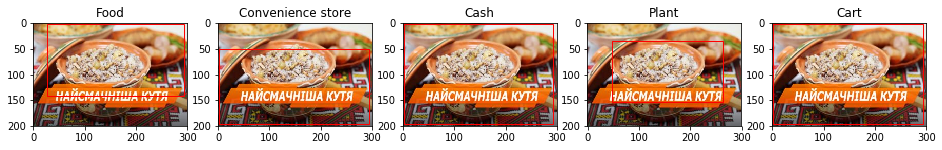

IC0011ZCU.jpg.ldcc


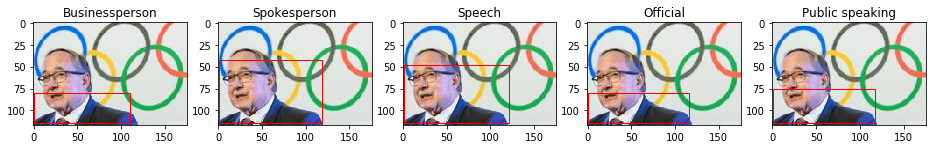

IC0011TFO.jpg.ldcc


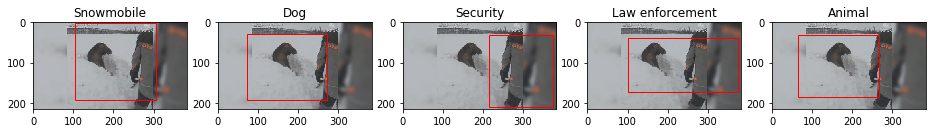

IC0011UPI.jpg.ldcc


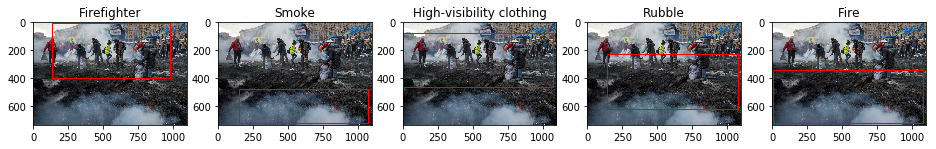

In [25]:
topk_vis = 5
for _ in range(50):
    filename = np.random.choice(test_img_filenames)
    imgid = filename.split('/')[-1]
    print(imgid)
    with open(filename, 'rb') as fin:
        _ = fin.read(1024)
        imgbin = fin.read()
    imgbgr = cv2.imdecode(np.fromstring(imgbin, dtype='uint8'), cv2.IMREAD_COLOR)
    imgrgb = imgbgr[:,:,[2,1,0]]        
    height, width, _ = imgrgb.shape

    #print([mid2name[item['label']] for item in annot[imgid]]) 
    
    fig, axes = plt.subplots(1, topk_vis, figsize=(16, 2))        
    
    for ii in range(topk_vis):
        axes[ii].imshow(imgrgb)
        axes[ii].set_title(mid2name[all_labels[det_results[imgid]['sorted_labels'][ii]]])
        for box in det_results[imgid]['sorted_bboxes'][ii][1::2]:
            axes[ii].add_patch(patches.Rectangle(
                (box[0]*width, box[1]*height), (box[2]-box[0])*width, (box[3]-box[1])*height,
                linewidth=1, edgecolor='r', facecolor='none'
            ))
            
    plt.show()

IC0011XC7.jpg.ldcc


/home/alireza/home_at_filer2/tools/anaconda3/envs/py3torch/lib/python3.6/site-packages/ipykernel/__main__.py:9: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


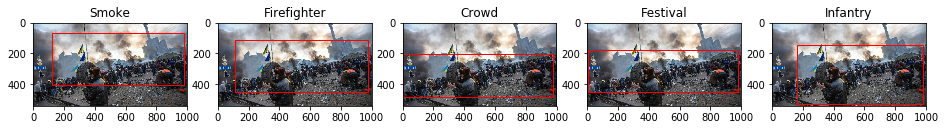

IC0011X1D.jpg.ldcc


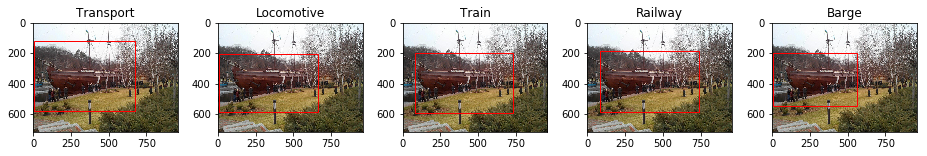

IC0011Y3X.jpg.ldcc


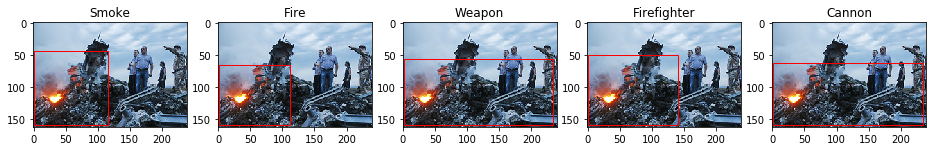

HC00025FB.jpg.ldcc


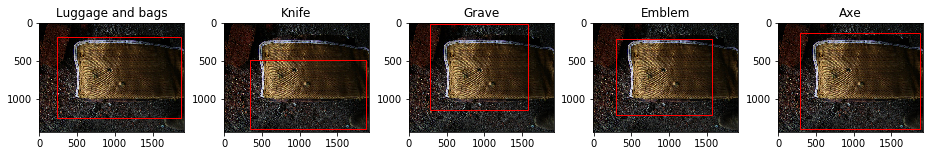

IC0011VUB.jpg.ldcc


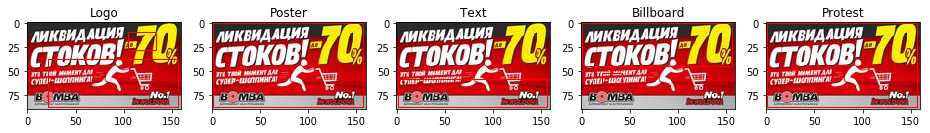

IC0011VRJ.jpg.ldcc


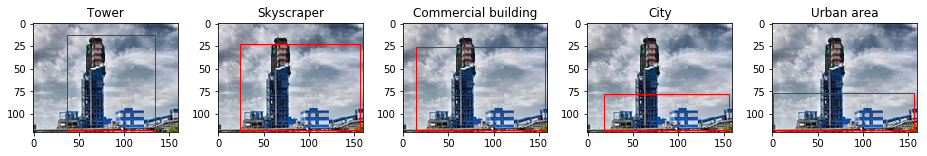

HC00000TL.jpg.ldcc


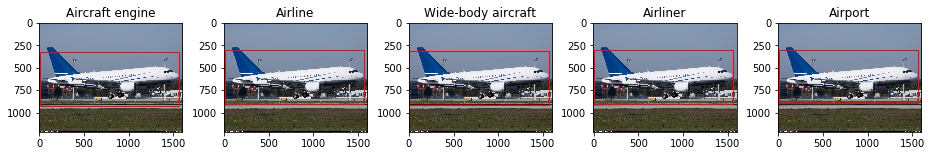

IC0012003.jpg.ldcc


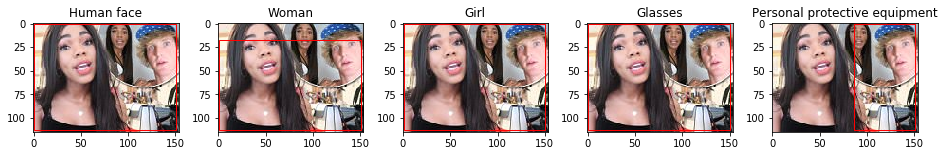

IC0011T4E.jpg.ldcc


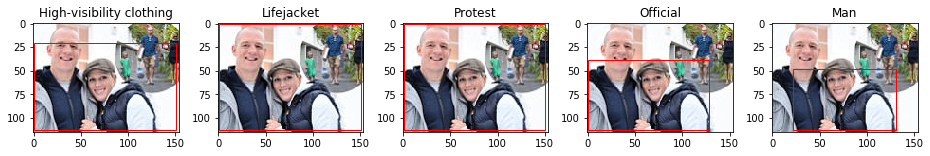

IC0011WQ0.jpg.ldcc


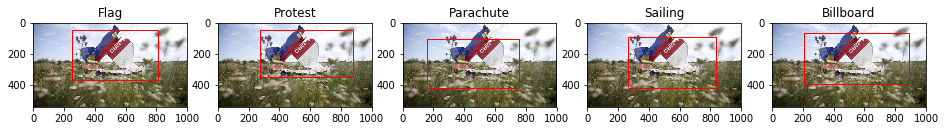

HC00000HJ.jpg.ldcc


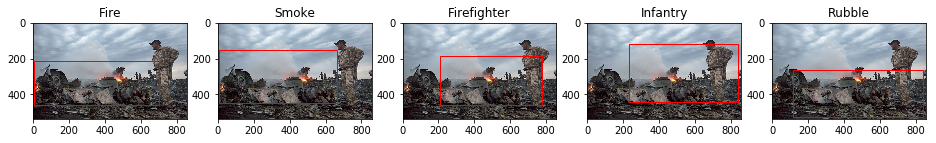

IC0011XIA.jpg.ldcc


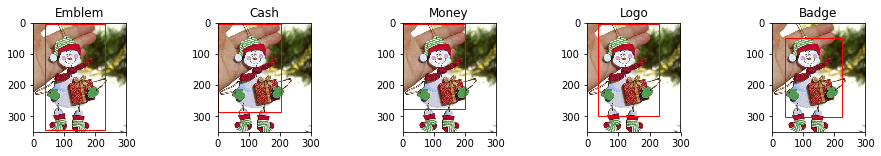

HC00000JB.jpg.ldcc


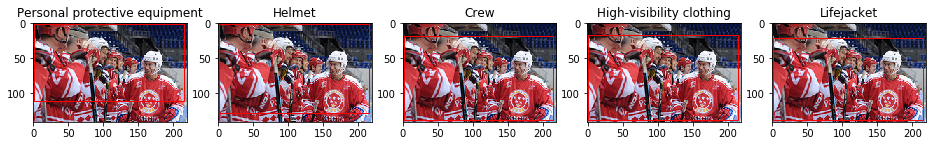

IC0011SXX.jpg.ldcc


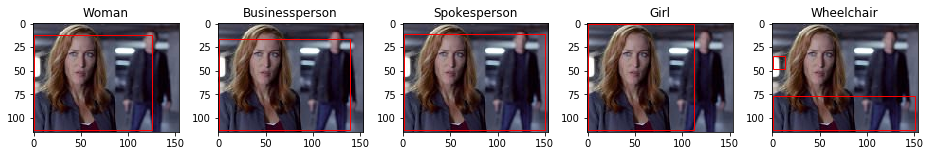

HC000Q8F5.jpg.ldcc


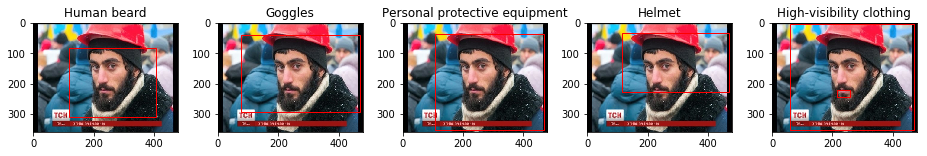

IC0011XIF.jpg.ldcc


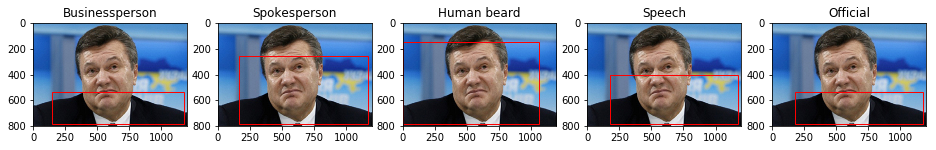

IC00152UT.jpg.ldcc


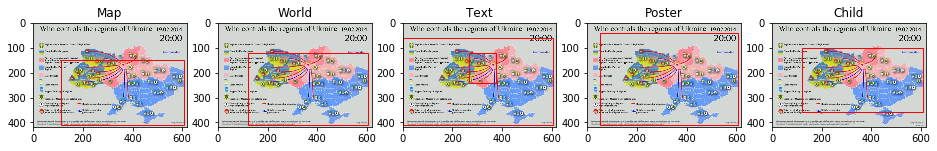

IC0011WQT.jpg.ldcc


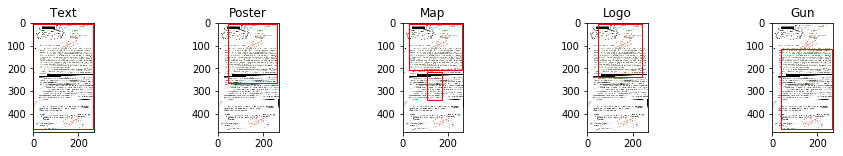

IC0011ULR.jpg.ldcc


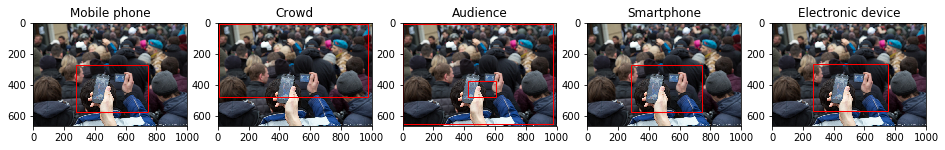

IC0011X1M.jpg.ldcc


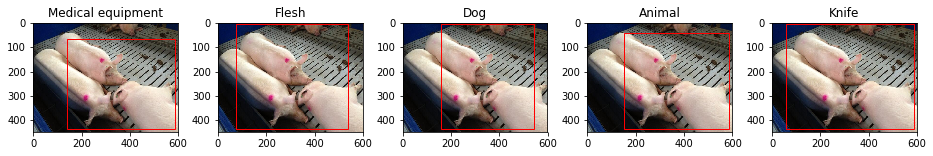

IC0011T2Q.jpg.ldcc


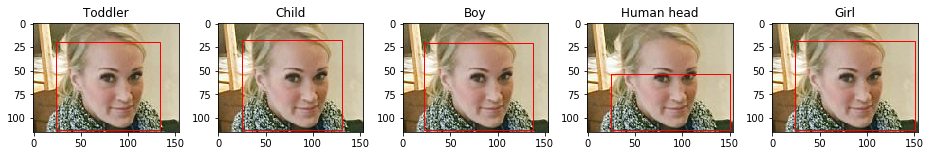

HC00000QR.jpg.ldcc


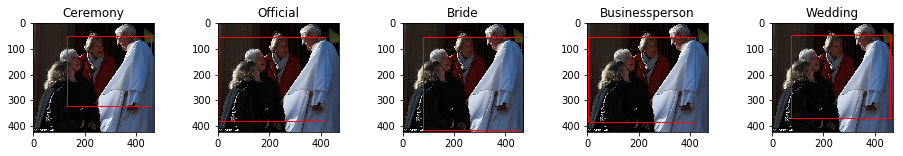

IC0011W28.jpg.ldcc


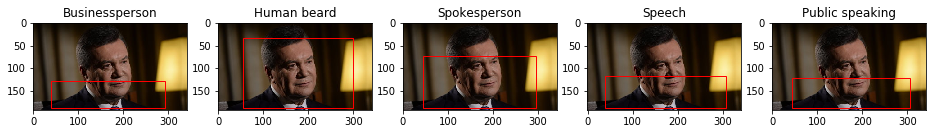

HC000ZJWK.jpg.ldcc


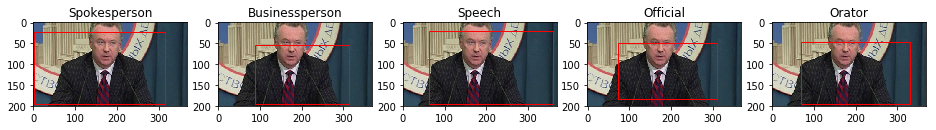

IC0011ULP.jpg.ldcc


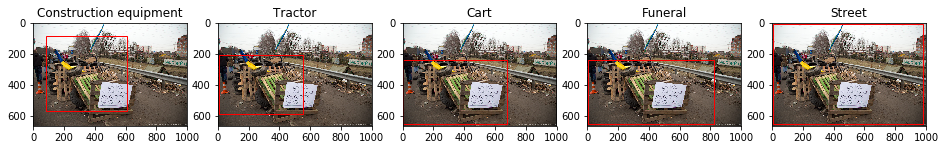

HC00000A3.jpg.ldcc


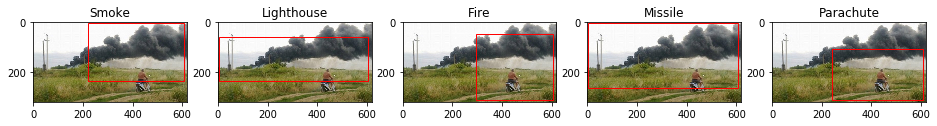

IC0011U1S.jpg.ldcc


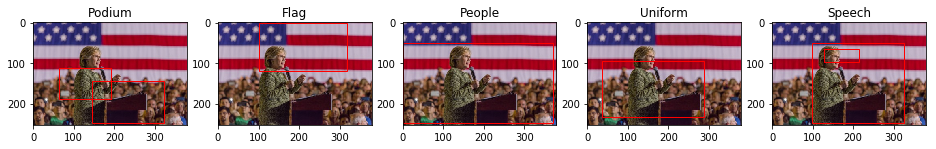

IC0011WMB.jpg.ldcc


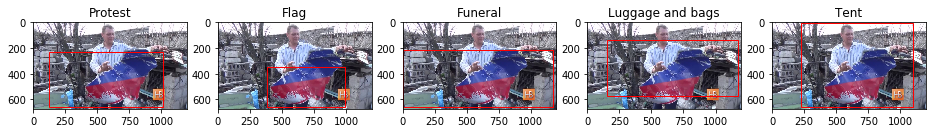

HC00000EX.jpg.ldcc


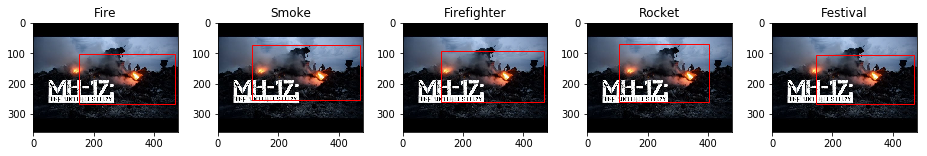

HC000SNTT.jpg.ldcc


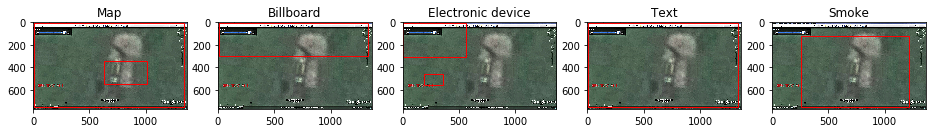

IC0011WRT.jpg.ldcc


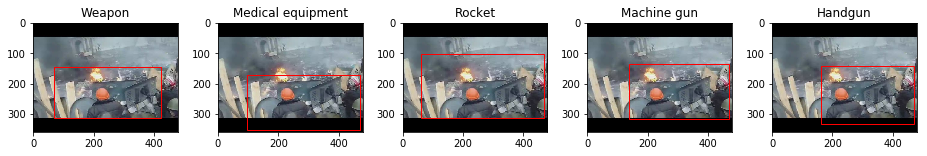

IC0011W52.jpg.ldcc


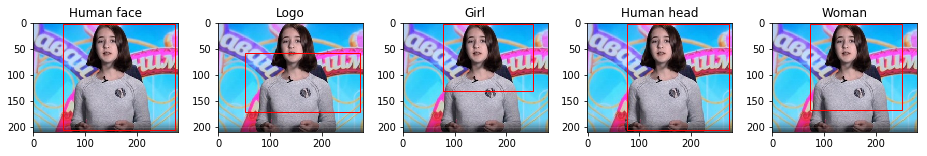

HC00000MK.jpg.ldcc


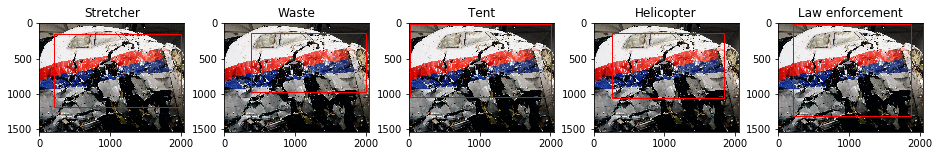

IC00120XO.jpg.ldcc


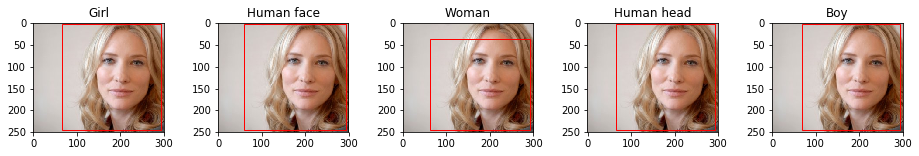

IC0011U09.jpg.ldcc


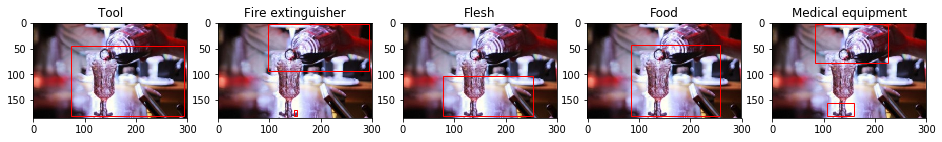

IC00120XH.jpg.ldcc


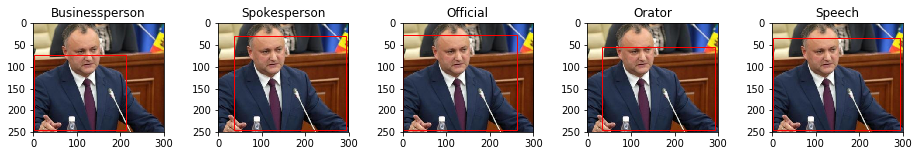

IC0011T9Q.jpg.ldcc


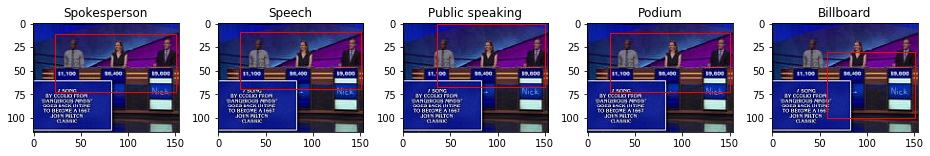

IC0015AN5.jpg.ldcc


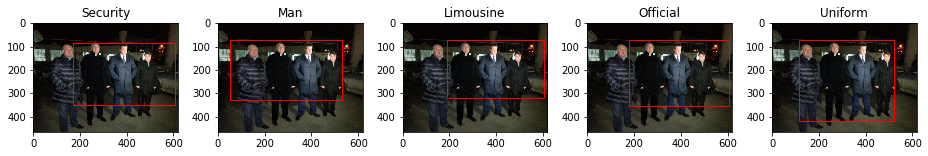

HC00000QI.jpg.ldcc


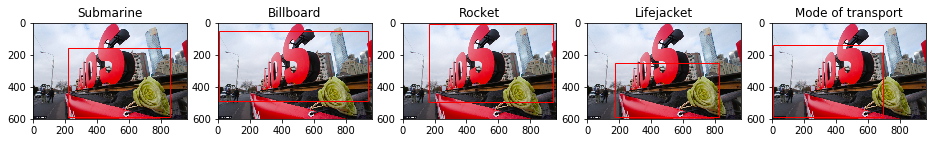

IC00120Y8.jpg.ldcc


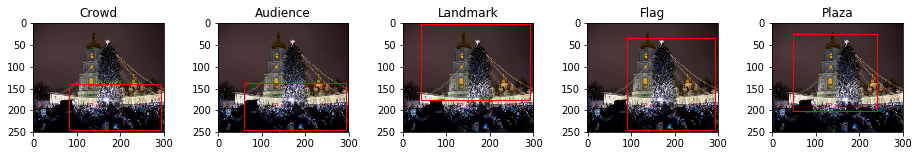

IC0011Z9B.jpg.ldcc


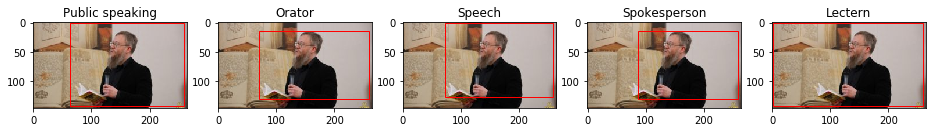

IC0011T98.jpg.ldcc


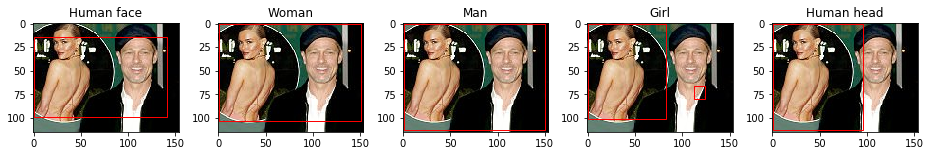

IC0011ZA4.jpg.ldcc


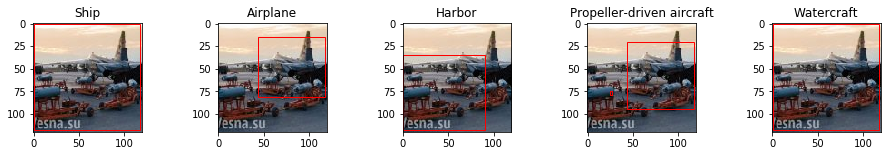

IC0011V15.jpg.ldcc


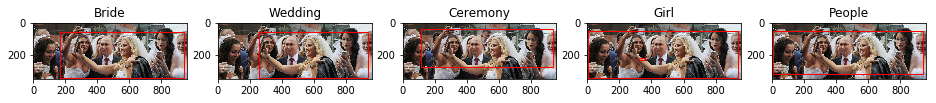

HC00000Q0.jpg.ldcc


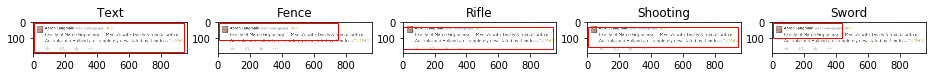

IC0011ZDH.jpg.ldcc


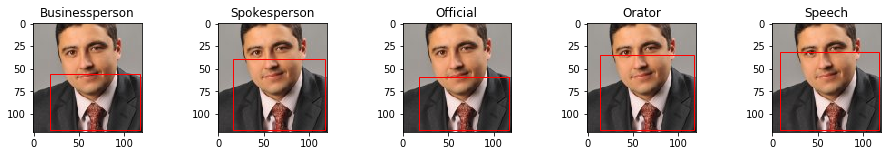

IC0011ZCV.jpg.ldcc


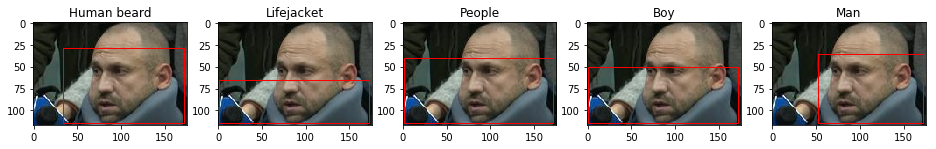

HC000SOLX.jpg.ldcc


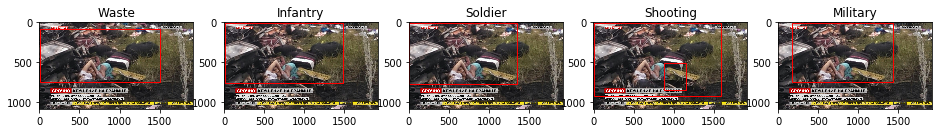

IC0011UPN.jpg.ldcc


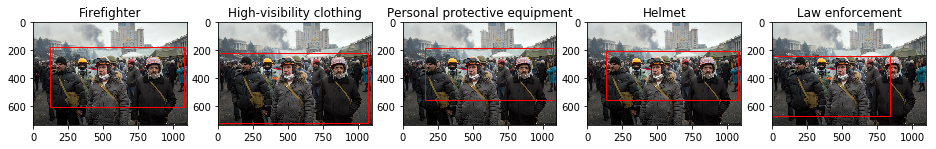

HC000SNTH.jpg.ldcc


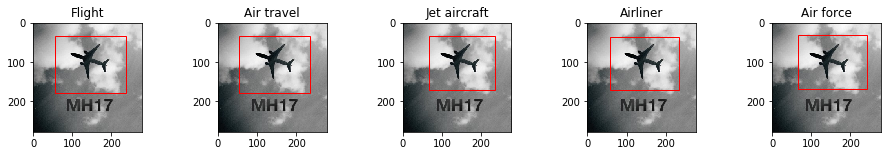

In [26]:
topk_vis = 5
for _ in range(50):
    filename = np.random.choice(test_img_filenames)
    imgid = filename.split('/')[-1]
    print(imgid)
    with open(filename, 'rb') as fin:
        _ = fin.read(1024)
        imgbin = fin.read()
    imgbgr = cv2.imdecode(np.fromstring(imgbin, dtype='uint8'), cv2.IMREAD_COLOR)
    imgrgb = imgbgr[:,:,[2,1,0]]        
    height, width, _ = imgrgb.shape

    #print([mid2name[item['label']] for item in annot[imgid]]) 
    
    fig, axes = plt.subplots(1, topk_vis, figsize=(16, 2))        
    
    for ii in range(topk_vis):
        axes[ii].imshow(imgrgb)
        axes[ii].set_title(mid2name[all_labels[det_results[imgid]['sorted_labels'][ii]]])
        for box in det_results[imgid]['sorted_bboxes'][ii][1::2]:
            axes[ii].add_patch(patches.Rectangle(
                (box[0]*width, box[1]*height), (box[2]-box[0])*width, (box[3]-box[1])*height,
                linewidth=1, edgecolor='r', facecolor='none'
            ))
            
    plt.show()

HC000SSQP.jpg.ldcc


/home/alireza/home_at_filer2/tools/anaconda3/envs/py3torch/lib/python3.6/site-packages/ipykernel/__main__.py:9: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


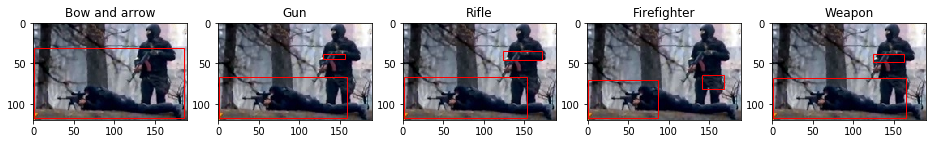

IC0011WZB.jpg.ldcc


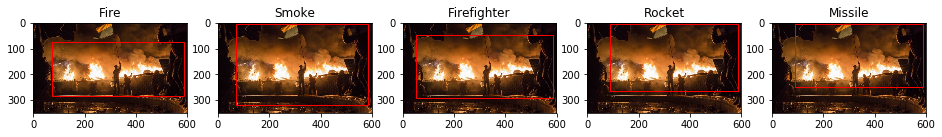

IC0011WGI.jpg.ldcc


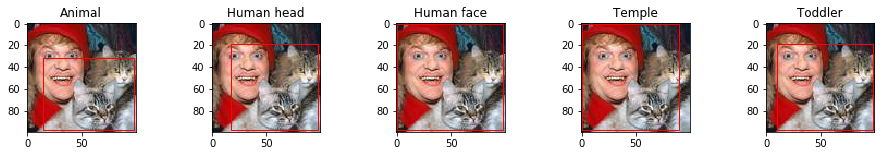

IC0011Z23.jpg.ldcc


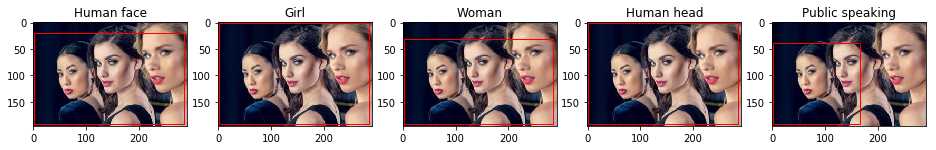

IC0011TNA.jpg.ldcc


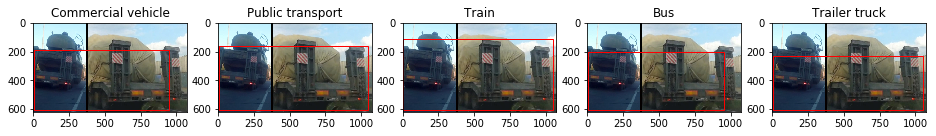

IC0015AN9.jpg.ldcc


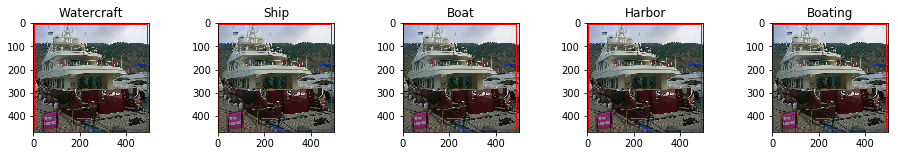

HC000SPMW.jpg.ldcc


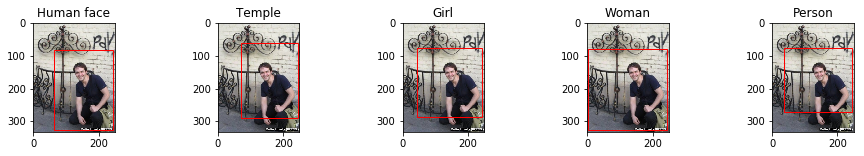

IC0011XZQ.jpg.ldcc


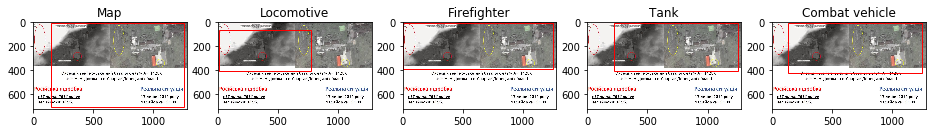

IC0011T9S.jpg.ldcc


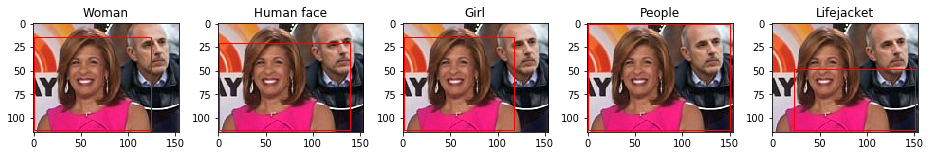

HC000Q8O8.jpg.ldcc


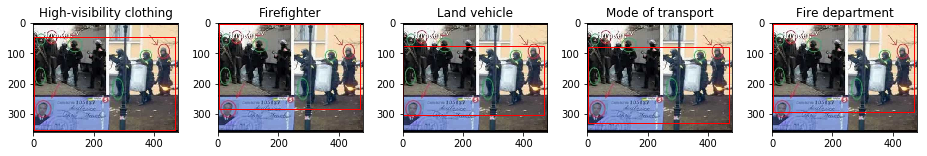

IC0011X50.jpg.ldcc


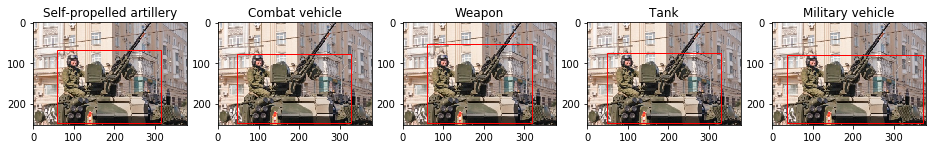

IC0011TDB.jpg.ldcc


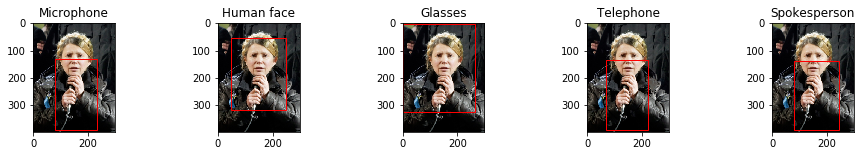

HC000SP4L.jpg.ldcc


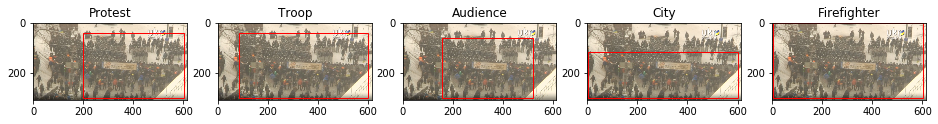

HC000SQEE.jpg.ldcc


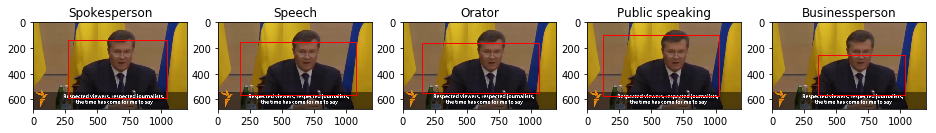

IC0011T9U.jpg.ldcc


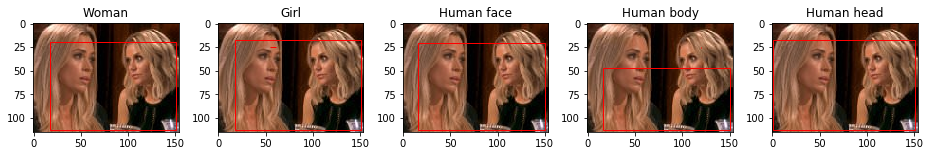

IC0011Z57.jpg.ldcc


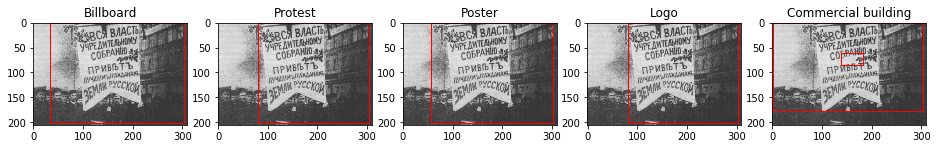

HC000ZJHT.jpg.ldcc


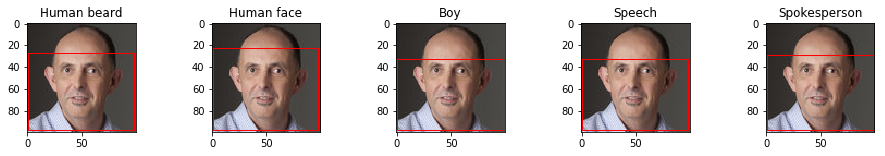

IC0011Y2J.jpg.ldcc


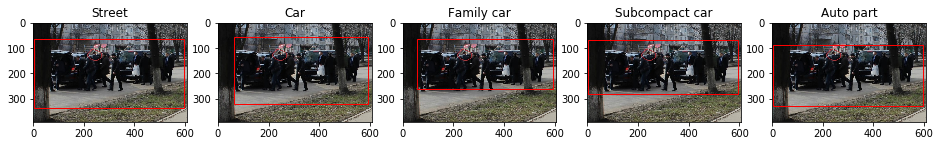

IC0011V8B.jpg.ldcc


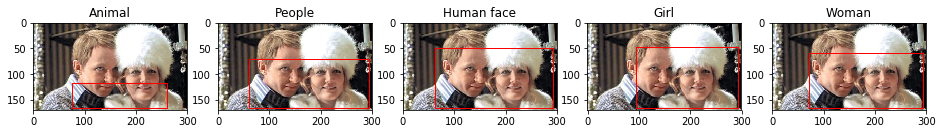

HC000SPOG.jpg.ldcc


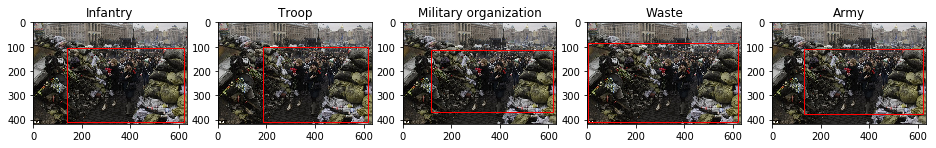

IC0011WKA.jpg.ldcc


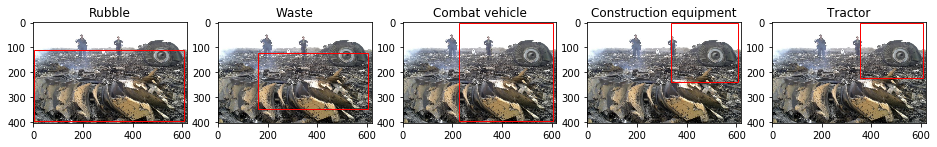

IC0011XXO.jpg.ldcc


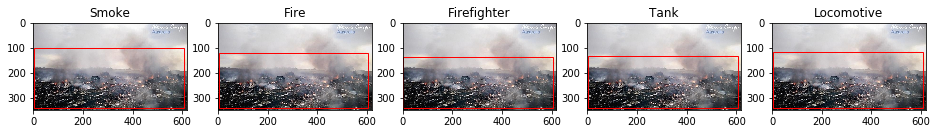

IC0011Y3O.jpg.ldcc


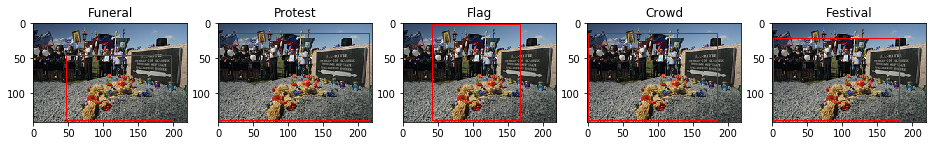

IC0011VC4.jpg.ldcc


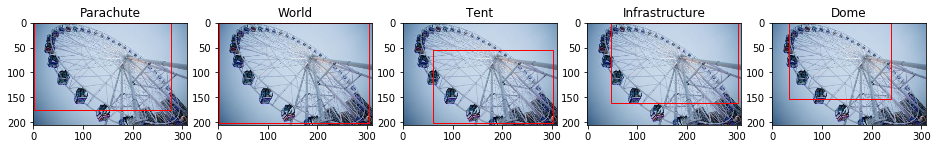

IC0011WJ7.jpg.ldcc


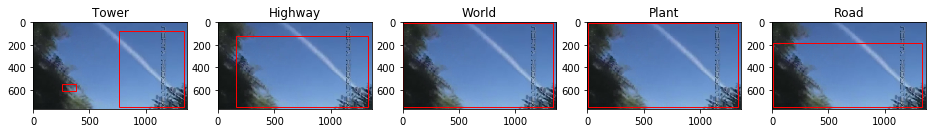

HC000ZKBV.jpg.ldcc


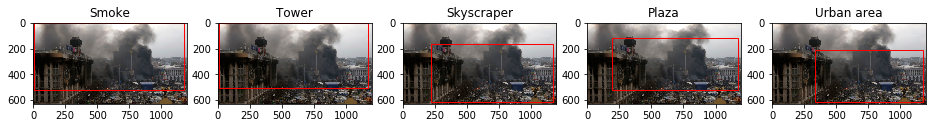

IC0011V1I.jpg.ldcc


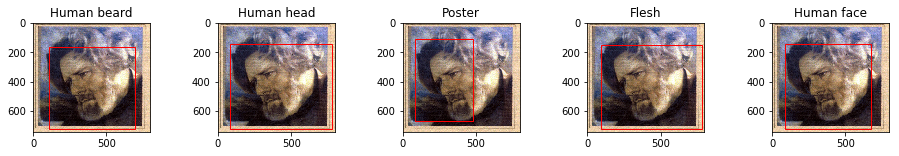

IC0011UFG.jpg.ldcc


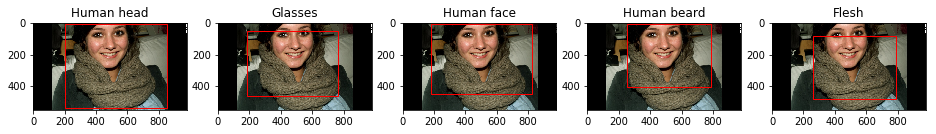

IC0015BFF.jpg.ldcc


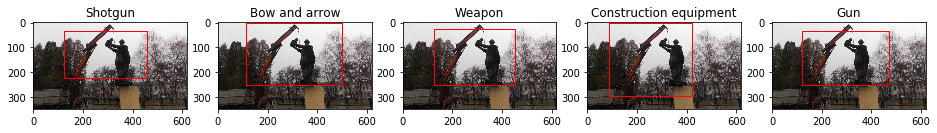

HC00025GL.jpg.ldcc


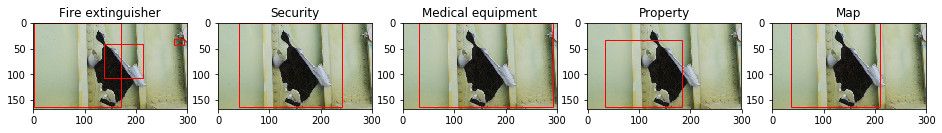

HC000ZIYX.jpg.ldcc


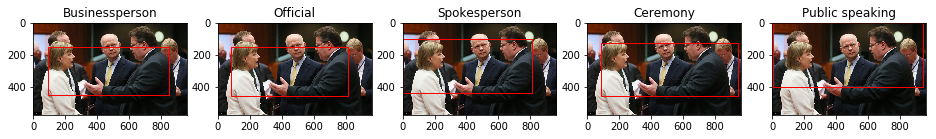

IC0011UFB.jpg.ldcc


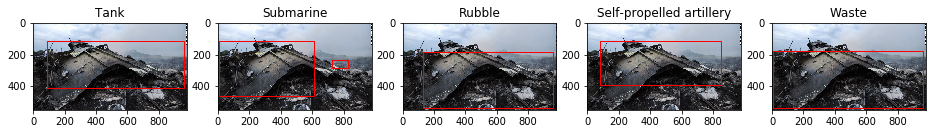

IC00120PE.jpg.ldcc


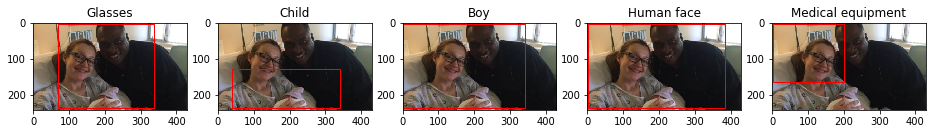

IC0011T7J.jpg.ldcc


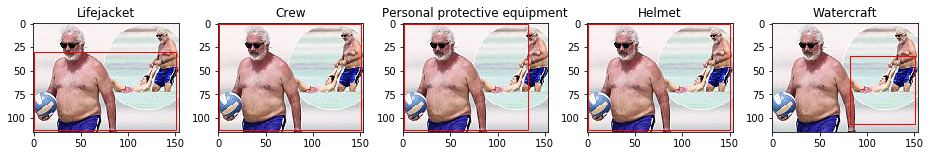

HC00025GJ.jpg.ldcc


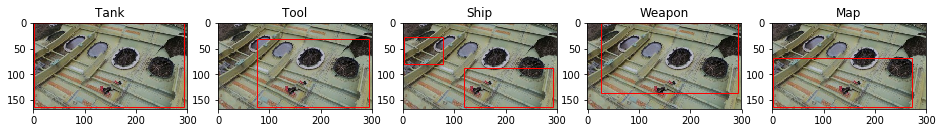

IC0011T1I.jpg.ldcc


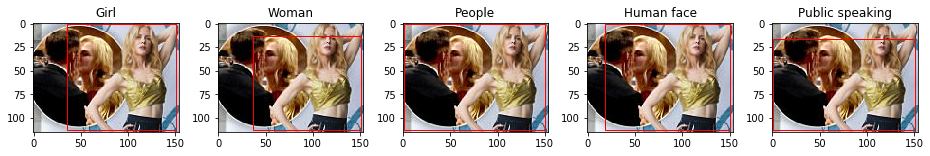

IC0011ZGB.jpg.ldcc


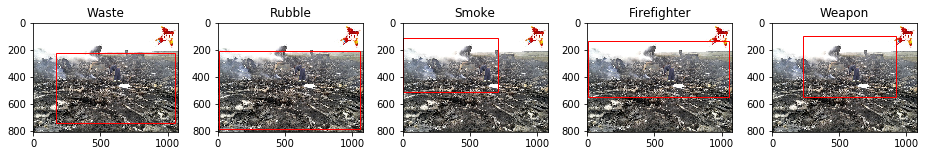

IC0011TNH.jpg.ldcc


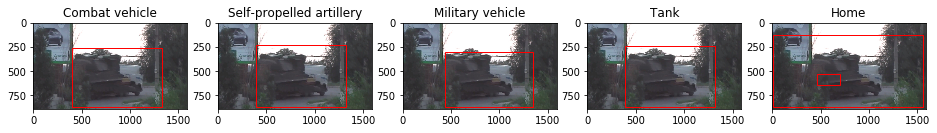

IC0011WVI.jpg.ldcc


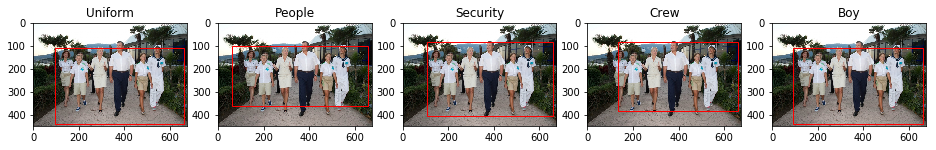

IC0011W7E.jpg.ldcc


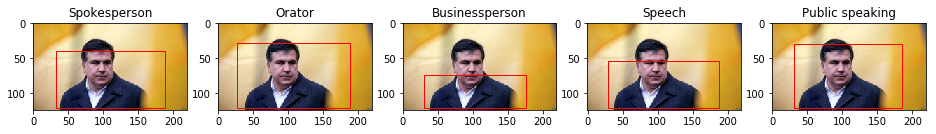

IC0011XMW.jpg.ldcc


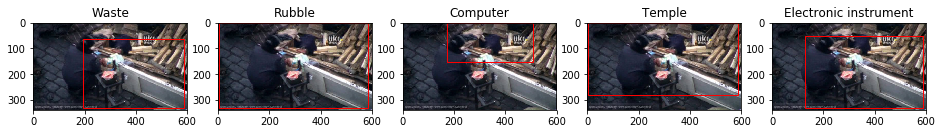

HC000ST2Y.jpg.ldcc


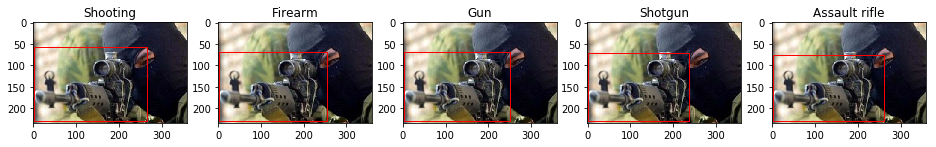

IC0011WFQ.jpg.ldcc


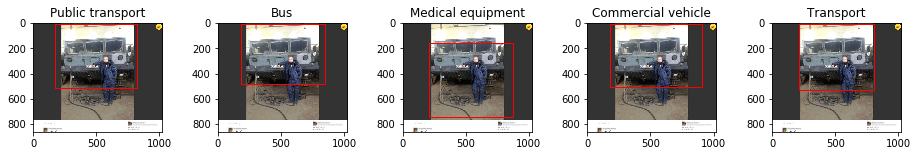

IC001203Z.jpg.ldcc


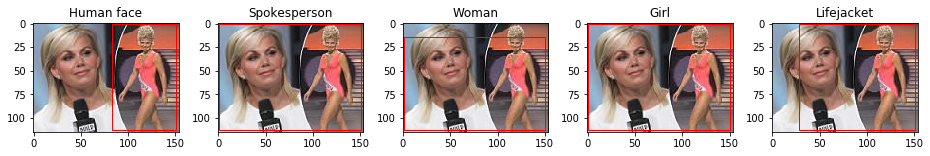

IC00120P7.jpg.ldcc


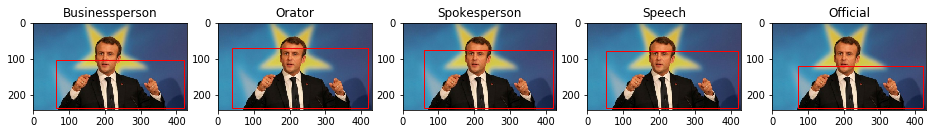

IC0011V8I.jpg.ldcc


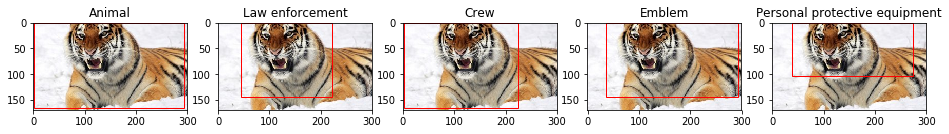

IC0011XGX.jpg.ldcc


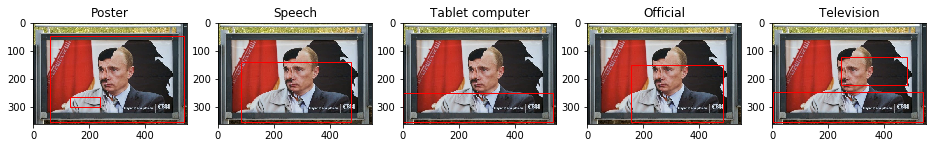

HC000ZIZF.jpg.ldcc


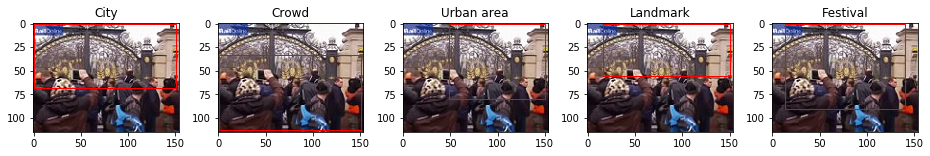

IC0011UDZ.jpg.ldcc


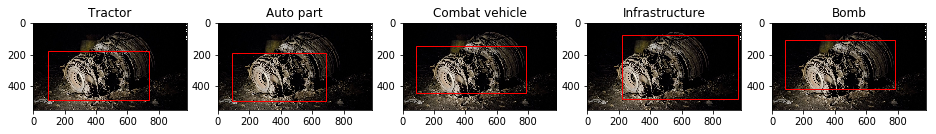

HC000SNWX.jpg.ldcc


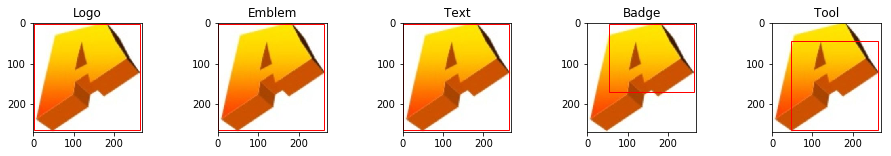

In [27]:
topk_vis = 5
for _ in range(50):
    filename = np.random.choice(test_img_filenames)
    imgid = filename.split('/')[-1]
    print(imgid)
    with open(filename, 'rb') as fin:
        _ = fin.read(1024)
        imgbin = fin.read()
    imgbgr = cv2.imdecode(np.fromstring(imgbin, dtype='uint8'), cv2.IMREAD_COLOR)
    imgrgb = imgbgr[:,:,[2,1,0]]        
    height, width, _ = imgrgb.shape

    #print([mid2name[item['label']] for item in annot[imgid]]) 
    
    fig, axes = plt.subplots(1, topk_vis, figsize=(16, 2))        
    
    for ii in range(topk_vis):
        axes[ii].imshow(imgrgb)
        axes[ii].set_title(mid2name[all_labels[det_results[imgid]['sorted_labels'][ii]]])
        for box in det_results[imgid]['sorted_bboxes'][ii][1::2]:
            axes[ii].add_patch(patches.Rectangle(
                (box[0]*width, box[1]*height), (box[2]-box[0])*width, (box[3]-box[1])*height,
                linewidth=1, edgecolor='r', facecolor='none'
            ))
            
    plt.show()

IC0011TAV.jpg.ldcc


/home/alireza/home_at_filer2/tools/anaconda3/envs/py3torch/lib/python3.6/site-packages/ipykernel/__main__.py:9: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


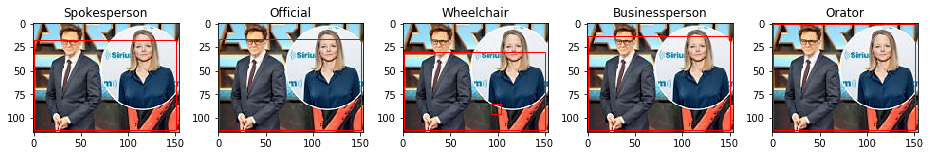

IC0011UP7.jpg.ldcc


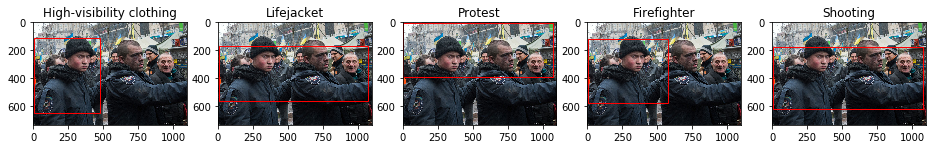

IC0011X4Z.jpg.ldcc


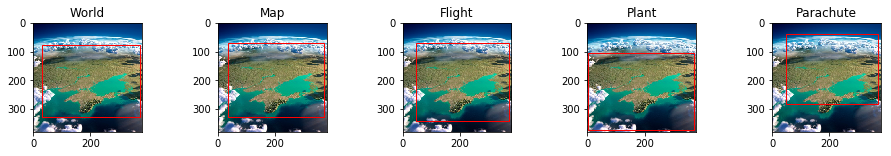

IC0011T9F.jpg.ldcc


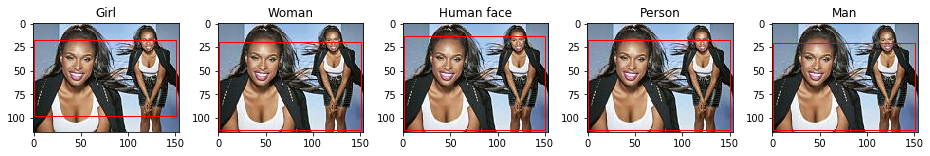

IC0011XIN.jpg.ldcc


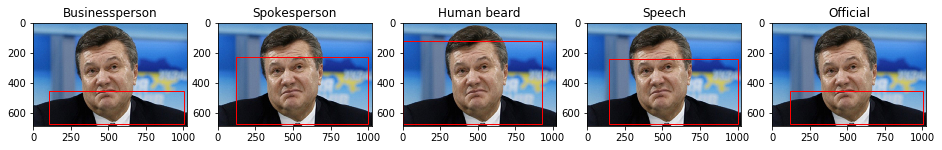

IC0011UEQ.jpg.ldcc


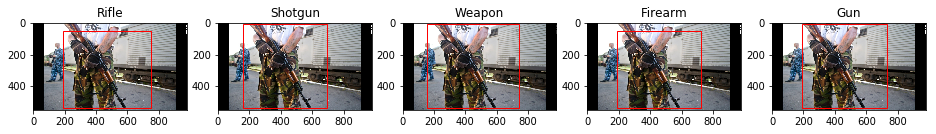

HC000SNSX.jpg.ldcc


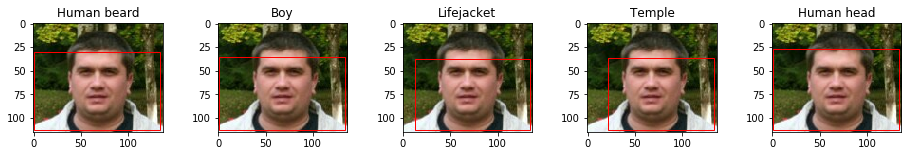

IC0011T9R.jpg.ldcc


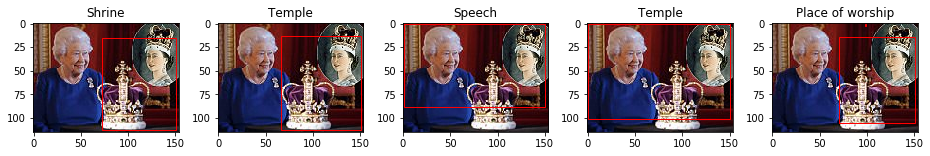

HC00001WH.jpg.ldcc


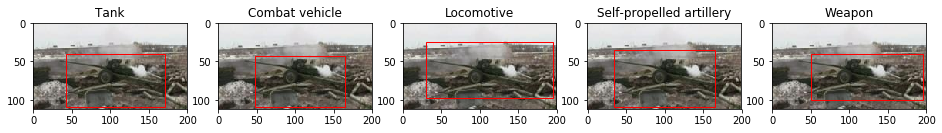

HC000SWL4.jpg.ldcc


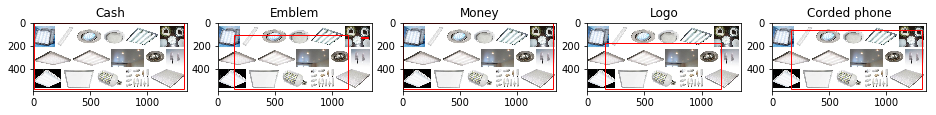

HC000SO9T.jpg.ldcc


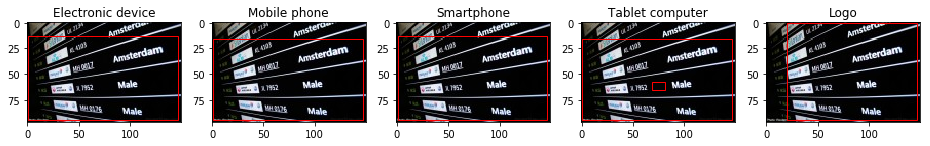

IC0011T81.jpg.ldcc


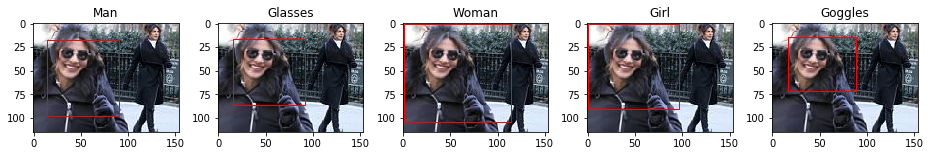

IC0011ZCW.jpg.ldcc


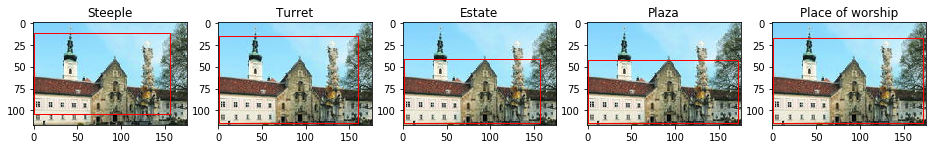

HC000ZIZI.jpg.ldcc


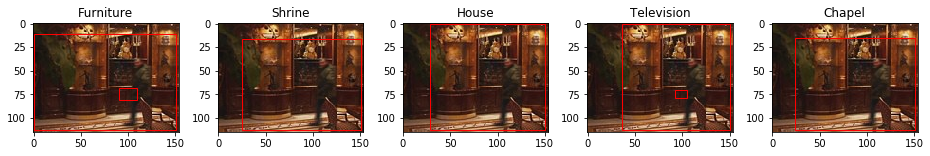

IC0011Y89.jpg.ldcc


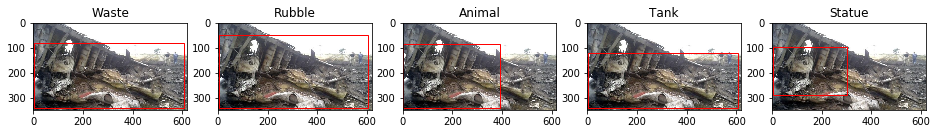

IC0011V5O.jpg.ldcc


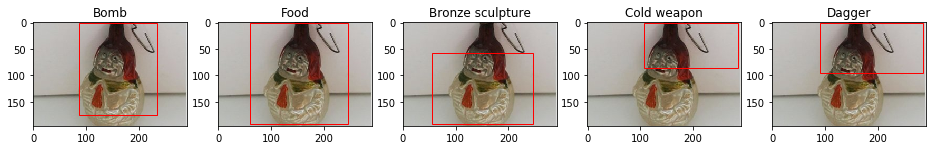

IC0011YO7.jpg.ldcc


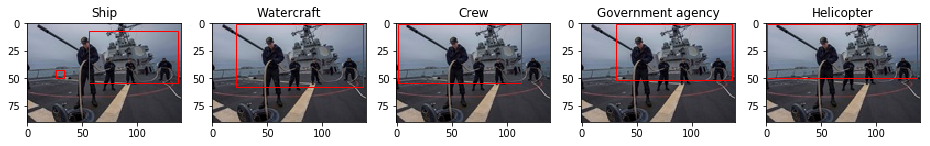

IC0011V6B.jpg.ldcc


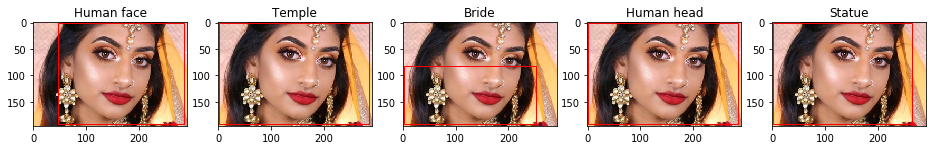

IC0011SSL.jpg.ldcc


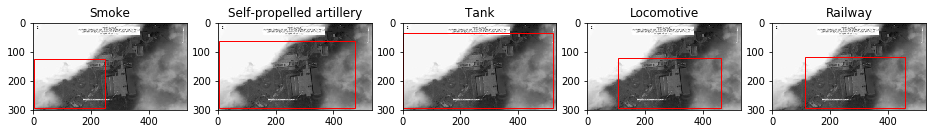

IC0011VB2.jpg.ldcc


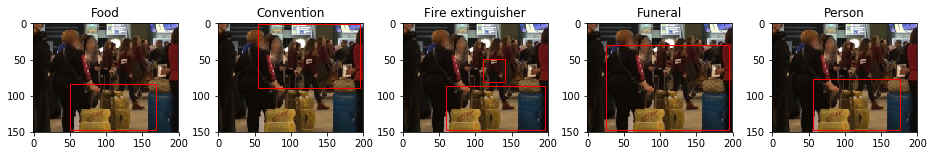

IC0011T1U.jpg.ldcc


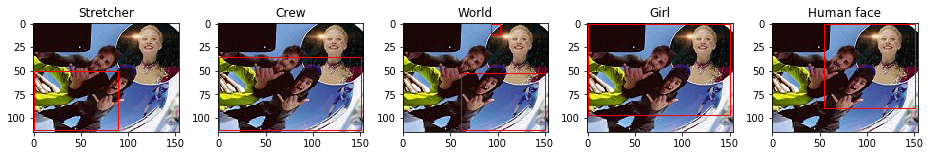

IC0011SP9.jpg.ldcc


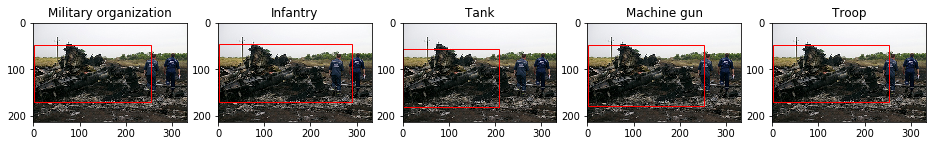

IC0011V7C.jpg.ldcc


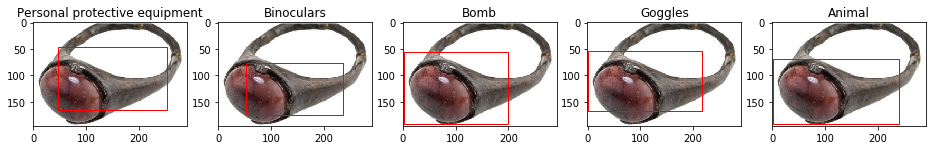

IC0011T8H.jpg.ldcc


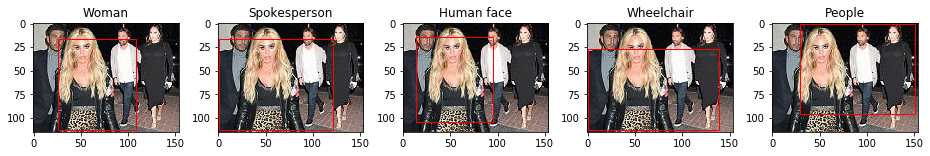

HC000Q8EY.jpg.ldcc


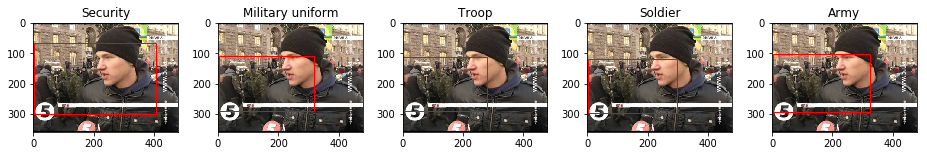

HC000SO9R.jpg.ldcc


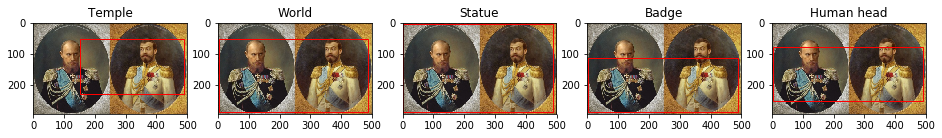

IC0011WZN.jpg.ldcc


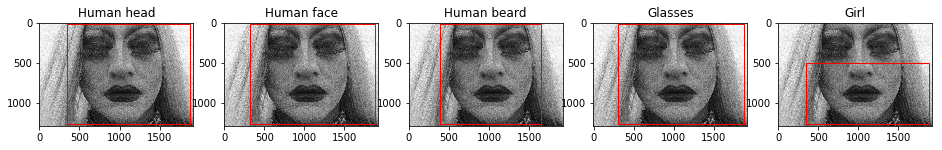

IC0011XUN.jpg.ldcc


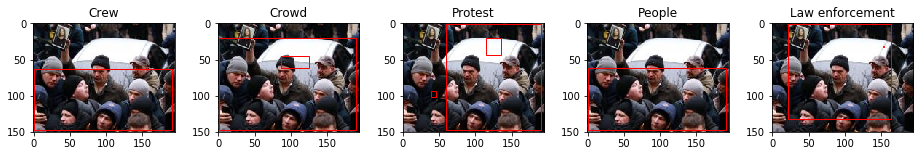

IC0011TAC.jpg.ldcc


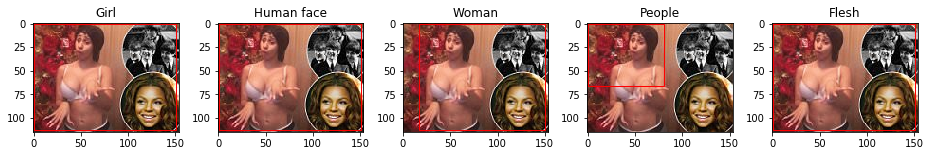

HC000Q8EK.jpg.ldcc


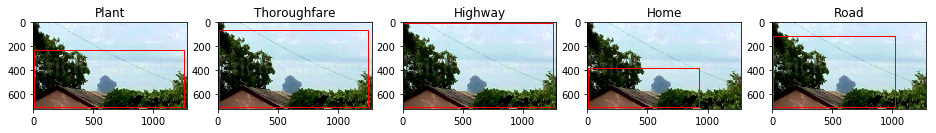

IC00157I3.jpg.ldcc


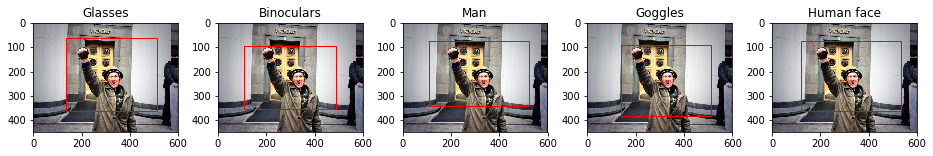

IC0011VRB.jpg.ldcc


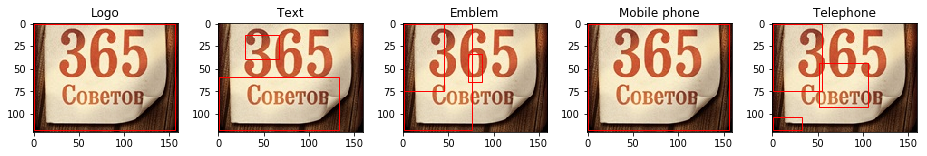

IC00120Y7.jpg.ldcc


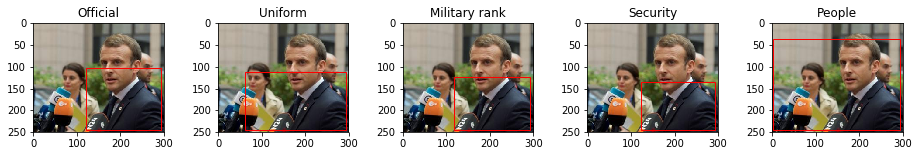

IC0011XM9.jpg.ldcc


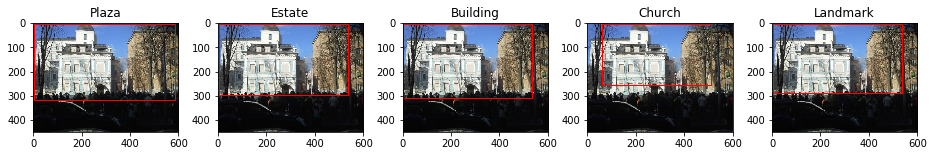

IC0011Z9Y.jpg.ldcc


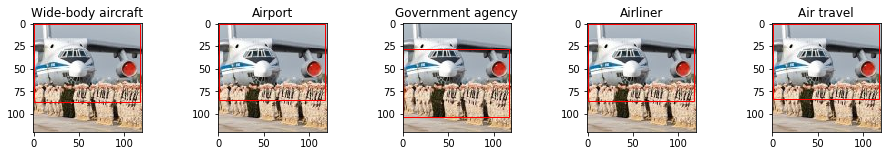

IC001203T.jpg.ldcc


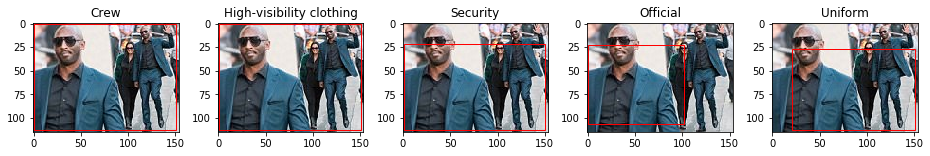

IC0011V0Q.jpg.ldcc


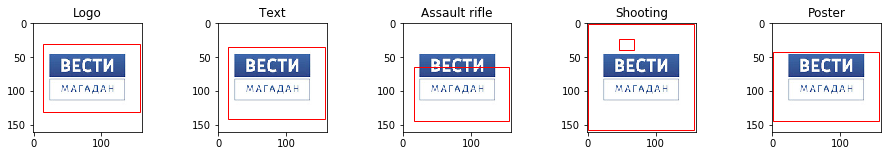

IC0011T90.jpg.ldcc


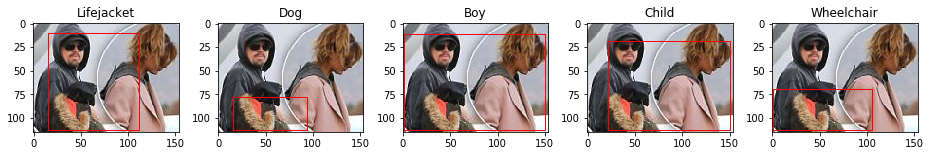

IC0011X1S.jpg.ldcc


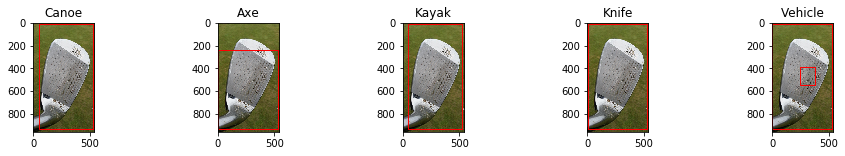

IC0011ZCL.jpg.ldcc


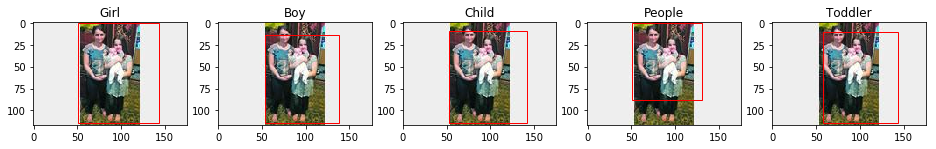

IC0011VOY.jpg.ldcc


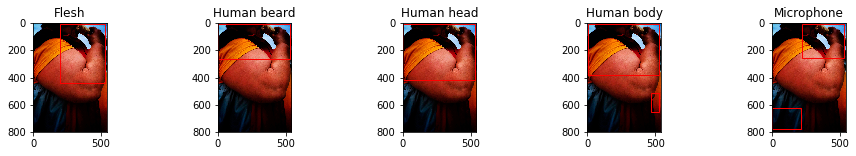

HC000ST1G.jpg.ldcc


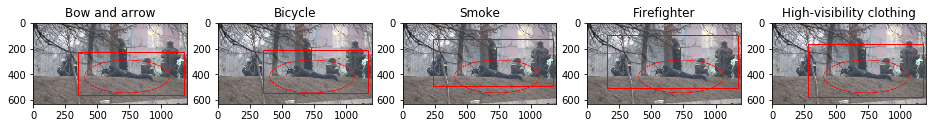

IC0011WPR.jpg.ldcc


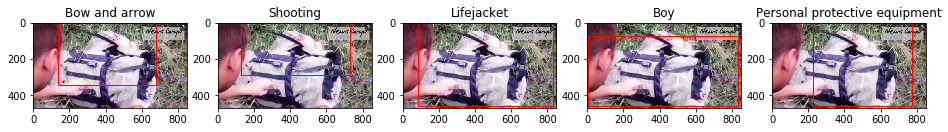

IC0011UGA.jpg.ldcc


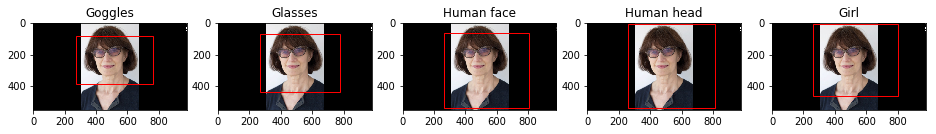

IC0011TDW.jpg.ldcc


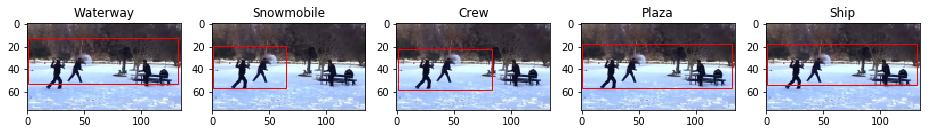

IC0011XNI.jpg.ldcc


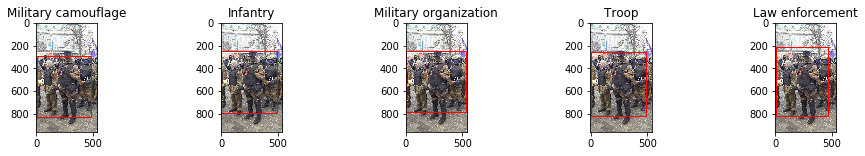

HC000SP4O.jpg.ldcc


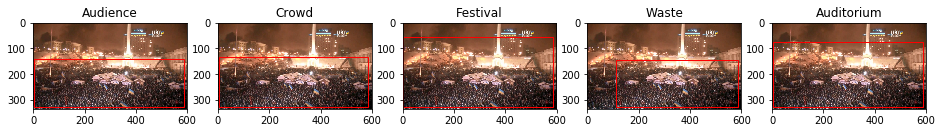

IC0011XKV.jpg.ldcc


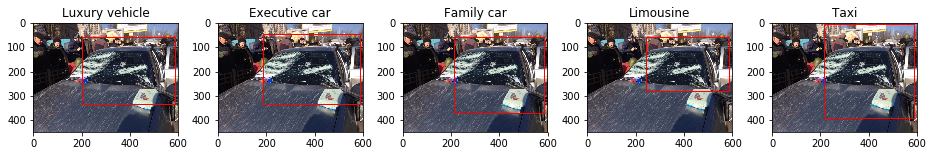

IC0011VIP.jpg.ldcc


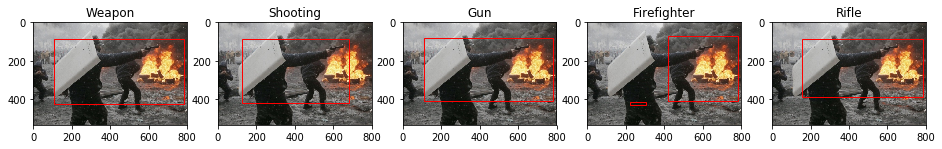

HC000SQGM.jpg.ldcc


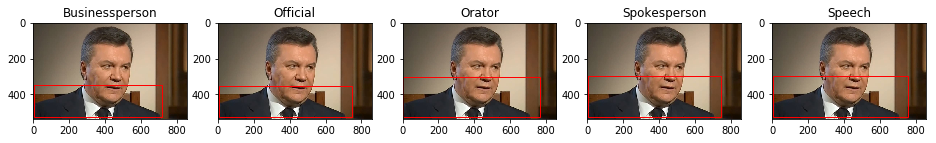

In [28]:
topk_vis = 5
for _ in range(50):
    filename = np.random.choice(test_img_filenames)
    imgid = filename.split('/')[-1]
    print(imgid)
    with open(filename, 'rb') as fin:
        _ = fin.read(1024)
        imgbin = fin.read()
    imgbgr = cv2.imdecode(np.fromstring(imgbin, dtype='uint8'), cv2.IMREAD_COLOR)
    imgrgb = imgbgr[:,:,[2,1,0]]        
    height, width, _ = imgrgb.shape

    #print([mid2name[item['label']] for item in annot[imgid]]) 
    
    fig, axes = plt.subplots(1, topk_vis, figsize=(16, 2))        
    
    for ii in range(topk_vis):
        axes[ii].imshow(imgrgb)
        axes[ii].set_title(mid2name[all_labels[det_results[imgid]['sorted_labels'][ii]]])
        for box in det_results[imgid]['sorted_bboxes'][ii][1::2]:
            axes[ii].add_patch(patches.Rectangle(
                (box[0]*width, box[1]*height), (box[2]-box[0])*width, (box[3]-box[1])*height,
                linewidth=1, edgecolor='r', facecolor='none'
            ))
            
    plt.show()